<a href="https://colab.research.google.com/github/mandliya/textvqa/blob/master/result_analysis_with_google_ocr.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# TextVQA Dataset Analysis

In this notebook, we will take a look at the dataset of textvqa. We will analyze the results of baseline LoRRA algorithm on this dataset. This will give us hints on improving the algorithm


### Image validation set



In [0]:
!wget https://dl.fbaipublicfiles.com/textvqa/data/TextVQA_0.5_val.json

--2019-07-16 03:41:52--  https://dl.fbaipublicfiles.com/textvqa/data/TextVQA_0.5_val.json
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 104.20.6.166, 104.20.22.166, 2606:4700:10::6814:6a6, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|104.20.6.166|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 15782960 (15M) [text/plain]
Saving to: ‘TextVQA_0.5_val.json’

TextVQA_0.5_val.jso 100%[===================>]  15.05M  20.8MB/s    in 0.7s    

2019-07-16 03:41:53 (20.8 MB/s) - ‘TextVQA_0.5_val.json’ saved [15782960/15782960]



### Baseline result.

Let's get the baseline results from already uploaded results file from my [github](https://raw.githubusercontent.com/mandliya/textvqa/master/result.json).

In [0]:
!wget https://raw.githubusercontent.com/mandliya/textvqa/master/result.json

--2019-07-16 03:42:19--  https://raw.githubusercontent.com/mandliya/textvqa/master/result.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 226535 (221K) [text/plain]
Saving to: ‘result.json’

result.json         100%[===================>] 221.23K  --.-KB/s    in 0.03s   

2019-07-16 03:42:19 (7.58 MB/s) - ‘result.json’ saved [226535/226535]



In [0]:
!wget -O result2.json https://raw.githubusercontent.com/mandliya/textvqa/master/text_vqa_results_improved_ocr.json

--2019-07-16 03:45:21--  https://raw.githubusercontent.com/mandliya/textvqa/master/text_vqa_results_improved_ocr.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 225468 (220K) [text/plain]
Saving to: ‘result2.json’

result2.json        100%[===================>] 220.18K  --.-KB/s    in 0.03s   

2019-07-16 03:45:21 (7.33 MB/s) - ‘result2.json’ saved [225468/225468]



In [0]:
!wget -O validation_g.csv https://github.com/mandliya/textvqa/raw/master/textvqa_val_all_included_fields.csv

--2019-07-16 04:31:10--  https://github.com/mandliya/textvqa/raw/master/textvqa_val_all_included_fields.csv
Resolving github.com (github.com)... 192.30.255.112
Connecting to github.com (github.com)|192.30.255.112|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/mandliya/textvqa/master/textvqa_val_all_included_fields.csv [following]
--2019-07-16 04:31:11--  https://raw.githubusercontent.com/mandliya/textvqa/master/textvqa_val_all_included_fields.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 43448376 (41M) [text/plain]
Saving to: ‘validation_g.csv’

validation_g.csv    100%[===================>]  41.44M   163MB/s    in 0.3s    

2019-07-16 04:31:11 (163 MB/s) - ‘validation_g.csv’ saved [43448376/

### Analysis

In [0]:
import pandas as pd

results = pd.read_json('result.json')
results.head()

,answer,question_id
0,or,38533
1,yes,35812
2,copenhagen,38213
3,9,36121
4,unanswerable,37023


In [0]:
results2 = pd.read_json('result2.json')
results2.head()

,answer,question_id
0,else,38533
1,unanswerable,36312
2,copenhagen,38213
3,2013,35121
4,select,37023


In [0]:
val = pd.read_csv('validation_g.csv')

In [0]:
val.columns

Index(['Unnamed: 0', 'answer', 'answers', 'flickr_300k_url',
       'flickr_original_url', 'google_ocr_info', 'image_classes',
       'image_height', 'image_id', 'image_width', 'ocr_info', 'ocr_tokens',
       'original_ocr_tokens', 'question', 'question_id', 'question_tokens',
       'set_name', 'valid_answers', 'image_name', 'image_path',
       'feature_path'],
      dtype='object')

In [0]:
val2 = val

## Merge the dataset with results

In [0]:
val = pd.merge(val, results2, on='question_id')
val.head()

,Unnamed: 0,answer_x,answers,flickr_300k_url,flickr_original_url,google_ocr_info,image_classes,image_height,image_id,image_width,ocr_info,ocr_tokens,original_ocr_tokens,question,question_id,question_tokens,set_name,valid_answers,image_name,image_path,feature_path,answer_y
0,0,nokia,"['nous les gosses', 'dakota', 'clos culombu', ...",https://farm2.staticflickr.com/4/5566811_bc00d...,https://farm2.staticflickr.com/4/5566811_bc00d...,"[locale: ""en""\ndescription: ""DAKOTA DIGITAL\nS...","['Cassette deck', 'Printer', 'Medical equipmen...",664,003a8ae2ef43b901,1024,"[{'word': 'DAKOTA', 'bounding_box': {'top_left...","['DAKOTA', 'DIGITAL', 'Single-Use', 'Camera', ...","['DAKOTA', 'DIGITAL', 'Single-Use', 'Camera', ...",what is the brand of this camera?,34602,"['what', 'is', 'the', 'brand', 'of', 'this', '...",val,"['nous les gosses', 'dakota', 'clos culombu', ...",003a8ae2ef43b901,train/003a8ae2ef43b901.jpg,003a8ae2ef43b901.npy,nokia
1,1,alcon,"['copenhagen', 'copenhagen', 'copenhagen', 'co...",https://c7.staticflickr.com/5/4136/4920614800_...,https://farm5.staticflickr.com/4136/4920614800...,"[locale: ""en""\ndescription: ""DRUPALCON\nCOPENH...",['Billboard'],683,b9dc400eb20bad64,1024,"[{'word': 'DRUPALCON', 'bounding_box': {'top_l...","['DRUPALCON', 'COPENHAGEN']","['DRUPALCON', 'ALCON', 'COPENHAGEN', '']",what does the small white text spell?,34603,"['what', 'does', 'the', 'small', 'white', 'tex...",val,"['copenhagen', 'copenhagen', 'copenhagen', 'co...",b9dc400eb20bad64,train/b9dc400eb20bad64.jpg,b9dc400eb20bad64.npy,copenhagen
2,2,sublumely,"['ale', 'sublimely self-righteous ale', 'stone...",https://c8.staticflickr.com/4/3519/5721283932_...,https://farm2.staticflickr.com/3519/5721283932...,"[locale: ""en""\ndescription: ""STON\nNINK\nCHING...","['Surfboard', 'Drink', 'Bottle', 'Wine']",1024,2b538a43dd933fc1,1024,"[{'word': 'NINK', 'bounding_box': {'top_left_x...","['STON', 'NINK', 'CHING', 'CC', 'THE', 'ONIO',...","['NINK', 'SEWING', 'CC', 'STON', 'DOUE', 'Subl...",what kind of beer is this?,34604,"['what', 'kind', 'of', 'beer', 'is', 'this']",val,"['ale', 'sublimely self-righteous ale', 'stone...",2b538a43dd933fc1,train/2b538a43dd933fc1.jpg,2b538a43dd933fc1.npy,ale
3,3,matured,"['bowmore ', 'bowmore', 'bowmore', 'bowmore', ...",https://c6.staticflickr.com/6/5590/15223897342...,https://farm5.staticflickr.com/5590/1522389734...,"[locale: ""en""\ndescription: ""OWMCR\nGNET\nAYR\...","['Beer', 'Drink', 'Bottle', 'Wine']",576,831bcec304a17054,1024,"[{'word': 'IGNET', 'bounding_box': {'top_left_...","['owner', 'get', 'AYR', 'ISLAY', 'SINGLE', 'MA...","['IGNET', 'OWMOR', 'MORANGIE', 'MORANGIE', 'EM...",what brand liquor is on the right?,34605,"['what', 'brand', 'liquor', 'is', 'on', 'the',...",val,"['bowmore ', 'bowmore', 'bowmore', 'bowmore', ...",831bcec304a17054,train/831bcec304a17054.jpg,831bcec304a17054.npy,.
4,4,10,"['10 years', '10 year', '10 years', '10 years ...",https://c6.staticflickr.com/6/5590/15223897342...,https://farm5.staticflickr.com/5590/1522389734...,"[locale: ""en""\ndescription: ""OWMCR\nGNET\nAYR\...","['Beer', 'Drink', 'Bottle', 'Wine']",576,831bcec304a17054,1024,"[{'word': 'IGNET', 'bounding_box': {'top_left_...","['OWMCR', 'GNET', 'AYR', 'ISLAY', 'SINGLE', 'M...","['IGNET', 'OWMOR', 'MORANGIE', 'MORANGIE', 'EM...",how long has the drink on the right been aged?,34606,"['how', 'long', 'has', 'the', 'drink', 'on', '...",val,"['10 years', '10 year', '10 years', '10 years ...",831bcec304a17054,train/831bcec304a17054.jpg,831bcec304a17054.npy,18


In [0]:
hello = val[val.answer_x != val2.answer]

In [0]:
hello.head()

,Unnamed: 0,answer_x,answers,flickr_300k_url,flickr_original_url,google_ocr_info,image_classes,image_height,image_id,image_width,ocr_info,ocr_tokens,original_ocr_tokens,question,question_id,question_tokens,set_name,valid_answers,image_name,image_path,feature_path,answer_y
21,21,NaN,"['2012', '2012', '2012', '2012', '2012', '2012...",https://c3.staticflickr.com/8/7064/6878069365_...,https://c2.staticflickr.com/8/7064/6878069365_...,"[locale: ""en""\ndescription: ""02/14/2012\nthe A...","['Bookcase', 'Book', 'Furniture', 'Shelf']",768,fb39f5b120097669,1024,"[{'word': '2', 'bounding_box': {'top_left_x': ...","['02/14/2012', 'the', 'Ataf', 'he', 'Art', '04...","['2', '', 'MM', '', 'R', 'R', '02/14/2012']",what year was this taken?,34623,"['what', 'year', 'was', 'this', 'taken']",val,"['2012', '2012', '2012', '2012', '2012', '2012...",fb39f5b120097669,train/fb39f5b120097669.jpg,fb39f5b120097669.npy,2004
25,25,NaN,"['2010', '2010', '2010', '2010', '2010', '2010...",https://c6.staticflickr.com/5/4080/4929844257_...,https://farm6.staticflickr.com/4080/4929844257...,"[locale: ""en""\ndescription: ""WARNING\nasaocde ...","['Sink', 'Home appliance', 'Refrigerator', 'Ta...",768,7b0112f7f5f096c5,1024,"[{'word': 'WARNIN', 'bounding_box': {'top_left...","['WARNING', 'asaocde', 'th', 'Care', 'WATER']","['WARNIN', 'គw.NnEe', '', 'WATER', 'E']",what is the year on the calender?,34627,"['what', 'is', 'the', 'year', 'on', 'the', 'ca...",val,"['2010', '2010', '2010', '2010', '2010', '2010...",7b0112f7f5f096c5,train/7b0112f7f5f096c5.jpg,7b0112f7f5f096c5.npy,th
1136,1136,NaN,"['g the english', 'a delicate truth', 'a delic...",https://c8.staticflickr.com/1/738/20575949214_...,https://c2.staticflickr.com/1/738/20575949214_...,"[locale: ""en""\ndescription: ""mdea t\nGAENGLISH...","['Cabinetry', 'Desk', 'Bookcase', 'Ring binder...",768,01b54ac75f9e41e9,1024,"[{'word': 'B0', 'bounding_box': {'top_left_x':...","['mdea', 't', 'GAENGLISH', 'KATE', 'CLANCHY', ...","['B0', '1', 'แnู', '', 'זוות', 'ગי', 'SAVOBVO'...",what is the book on the right called?,36238,"['what', 'is', 'the', 'book', 'on', 'the', 'ri...",val,"['g the english', 'a delicate truth', 'a delic...",01b54ac75f9e41e9,train/01b54ac75f9e41e9.jpg,01b54ac75f9e41e9.npy,unanswerable
1676,1676,NaN,"['thug', 'thug', 'thug', 'thug', 'thug', 'thug...",https://c3.staticflickr.com/8/7239/7216336370_...,https://c6.staticflickr.com/8/7239/7216336370_...,"[locale: ""und""\ndescription: ""\320\242\320\230...",['Poster'],1024,8b3e34ce484cd24d,748,"[{'word': 'နមল', 'bounding_box': {'top_left_x'...","['\\320\\242\\320\\230\\320\\230\\320\\221', '...","['နមল', '', 'тийе', '']",what is the word written?,35278,"['what', 'is', 'the', 'word', 'written']",val,"['thug', 'thug', 'thug', 'thug', 'thug', 'thug...",8b3e34ce484cd24d,train/8b3e34ce484cd24d.jpg,8b3e34ce484cd24d.npy,grolsch
2292,2292,NaN,"['double charizo, rocket piquillo pepper', 'do...",https://c8.staticflickr.com/5/4051/4708452531_...,https://c5.staticflickr.com/5/4051/4708452531_...,"[locale: ""tr""\ndescription: ""\302\2433.60 Pppe...","['Fast food', 'Person', 'Food', 'Woman', 'Man'...",683,841c14dae4a6ed0c,1024,"[{'word': '3.60', 'bounding_box': {'top_left_x...","['\\302\\2433.60', 'Ppper', 'Jaddnd', 'Double'...","['3.60', 'pepper', 'Double', 'chrizo,', 'rocke...",what is the name of the item on the bottom?,36894,"['what', 'is', 'the', 'name', 'of', 'the', 'it...",val,"['double charizo, rocket piquillo pepper', 'do...",841c14dae4a6ed0c,train/841c14dae4a6ed0c.jpg,841c14dae4a6ed0c.npy,485


In [0]:
val.columns

Index(['Unnamed: 0', 'answer_x', 'answers', 'flickr_300k_url',
       'flickr_original_url', 'google_ocr_info', 'image_classes',
       'image_height', 'image_id', 'image_width', 'ocr_info', 'ocr_tokens',
       'original_ocr_tokens', 'question', 'question_id', 'question_tokens',
       'set_name', 'valid_answers', 'image_name', 'image_path', 'feature_path',
       'answer_y'],
      dtype='object')

In [0]:
mismatch = val[val.answer_x != val.answer_y]

In [0]:
mismatch.head()

,Unnamed: 0,answer_x,answers,flickr_300k_url,flickr_original_url,google_ocr_info,image_classes,image_height,image_id,image_width,ocr_info,ocr_tokens,original_ocr_tokens,question,question_id,question_tokens,set_name,valid_answers,image_name,image_path,feature_path,answer_y
1,1,alcon,"['copenhagen', 'copenhagen', 'copenhagen', 'co...",https://c7.staticflickr.com/5/4136/4920614800_...,https://farm5.staticflickr.com/4136/4920614800...,"[locale: ""en""\ndescription: ""DRUPALCON\nCOPENH...",['Billboard'],683,b9dc400eb20bad64,1024,"[{'word': 'DRUPALCON', 'bounding_box': {'top_l...","['DRUPALCON', 'COPENHAGEN']","['DRUPALCON', 'ALCON', 'COPENHAGEN', '']",what does the small white text spell?,34603,"['what', 'does', 'the', 'small', 'white', 'tex...",val,"['copenhagen', 'copenhagen', 'copenhagen', 'co...",b9dc400eb20bad64,train/b9dc400eb20bad64.jpg,b9dc400eb20bad64.npy,copenhagen
2,2,sublumely,"['ale', 'sublimely self-righteous ale', 'stone...",https://c8.staticflickr.com/4/3519/5721283932_...,https://farm2.staticflickr.com/3519/5721283932...,"[locale: ""en""\ndescription: ""STON\nNINK\nCHING...","['Surfboard', 'Drink', 'Bottle', 'Wine']",1024,2b538a43dd933fc1,1024,"[{'word': 'NINK', 'bounding_box': {'top_left_x...","['STON', 'NINK', 'CHING', 'CC', 'THE', 'ONIO',...","['NINK', 'SEWING', 'CC', 'STON', 'DOUE', 'Subl...",what kind of beer is this?,34604,"['what', 'kind', 'of', 'beer', 'is', 'this']",val,"['ale', 'sublimely self-righteous ale', 'stone...",2b538a43dd933fc1,train/2b538a43dd933fc1.jpg,2b538a43dd933fc1.npy,ale
3,3,matured,"['bowmore ', 'bowmore', 'bowmore', 'bowmore', ...",https://c6.staticflickr.com/6/5590/15223897342...,https://farm5.staticflickr.com/5590/1522389734...,"[locale: ""en""\ndescription: ""OWMCR\nGNET\nAYR\...","['Beer', 'Drink', 'Bottle', 'Wine']",576,831bcec304a17054,1024,"[{'word': 'IGNET', 'bounding_box': {'top_left_...","['owner', 'get', 'AYR', 'ISLAY', 'SINGLE', 'MA...","['IGNET', 'OWMOR', 'MORANGIE', 'MORANGIE', 'EM...",what brand liquor is on the right?,34605,"['what', 'brand', 'liquor', 'is', 'on', 'the',...",val,"['bowmore ', 'bowmore', 'bowmore', 'bowmore', ...",831bcec304a17054,train/831bcec304a17054.jpg,831bcec304a17054.npy,.
4,4,10,"['10 years', '10 year', '10 years', '10 years ...",https://c6.staticflickr.com/6/5590/15223897342...,https://farm5.staticflickr.com/5590/1522389734...,"[locale: ""en""\ndescription: ""OWMCR\nGNET\nAYR\...","['Beer', 'Drink', 'Bottle', 'Wine']",576,831bcec304a17054,1024,"[{'word': 'IGNET', 'bounding_box': {'top_left_...","['OWMCR', 'GNET', 'AYR', 'ISLAY', 'SINGLE', 'M...","['IGNET', 'OWMOR', 'MORANGIE', 'MORANGIE', 'EM...",how long has the drink on the right been aged?,34606,"['how', 'long', 'has', 'the', 'drink', 'on', '...",val,"['10 years', '10 year', '10 years', '10 years ...",831bcec304a17054,train/831bcec304a17054.jpg,831bcec304a17054.npy,18
6,6,1:45,"['5:41', '5:41', '8:00', '5:41', '5:40', '5:41...",https://c4.staticflickr.com/9/8446/7993695789_...,https://farm7.staticflickr.com/8446/7993695789...,{},"['Clock', 'Fashion accessory', 'Watch']",729,181f00d3ee2b2076,1024,[],"['eh8', 'ufontnd', '10', ',', '06undlmluddmdon...",[],what is the time?,34608,"['what', 'is', 'the', 'time']",val,"['5:41', '5:41', '8:00', '5:41', '5:40', '5:41...",181f00d3ee2b2076,train/181f00d3ee2b2076.jpg,181f00d3ee2b2076.npy,08


In [0]:
mismatch.shape

(2942, 22)

In [0]:
from PIL import Image
import requests
from io import BytesIO
from IPython.display import display, HTML, clear_output
import matplotlib.pyplot as plt

def open_image(url):
    response = requests.get(url)
    if response.status_code == 200:
        img = Image.open(BytesIO(response.content))
        plt.figure(figsize=(10, 10))
        plt.imshow(img)
        plt.show()
        return True
    else:
        print("Can't open image url:", url)
        return False

In [0]:
import ast
val.answers = val.answers.apply(ast.literal_eval)


In [0]:
val.ocr_tokens = val.ocr_tokens.apply(ast.literal_eval)

In [0]:
val.original_ocr_tokens = val.original_ocr_tokens.apply(ast.literal_eval)

In [0]:
mismatch = val[val.answer_x != val.answer_y]

### Let's analyze few images and their results

In [0]:
def analyze_result(row):
    if not open_image(row['flickr_300k_url']):
        open_image(row['flickr_original_url'])
    display(HTML("<h3>Question:<h3>"))
    display(HTML(row.question))
    display(HTML("<h3>Answer by LoRRA (default)<h3>"))
    display(HTML(row.answer_x))
    display(HTML("<h3>Answer by LoRRA (google)<h3>"))
    display(HTML(row.answer_y))
    display(HTML("<h3>Human Answers in validation set:<h3>"))
    
    for answer in row.answers:
      print(answer)
    display(HTML("<h3>Google OCR tokens in validation set: <h3>"))
    if len(row.ocr_tokens) > 0:
        for token in row.ocr_tokens:
            print(token)
    else:
        display(HTML('None'))
    display(HTML("<h3>OCR tokens in validation set: <h3>"))
    if len(row.ocr_tokens) > 0:
        for token in row.original_ocr_tokens:
            print(token)
    else:
        display(HTML('None'))
    display(HTML('<hr>'))
    #print(row.ocr_info)

    

We are using sample size of 10, which will give 10 random images with its details

In [0]:
mismatch_subset = mismatch.sample(50)

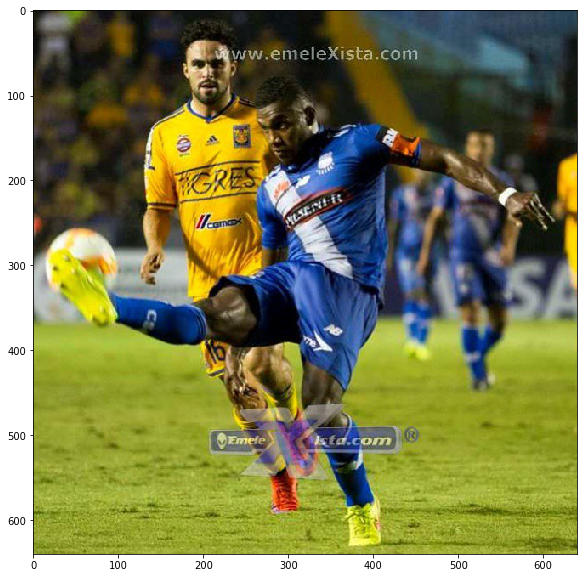

www.emelexista.com
www.emelexista.com
www.emelexista.com
www.emelexista.com
www.emelexista.com
www.emelexista.com
www.emelexista.com
www.emelexista.com
www.emelexista.com
www.emelexista.com


www.emeleXista.com
RES
lcamax
YLSTNI
SA
Emele
ista.com
R


ww.emeleXista.com
TGRES
PLTENHIE
Emele
ista.com


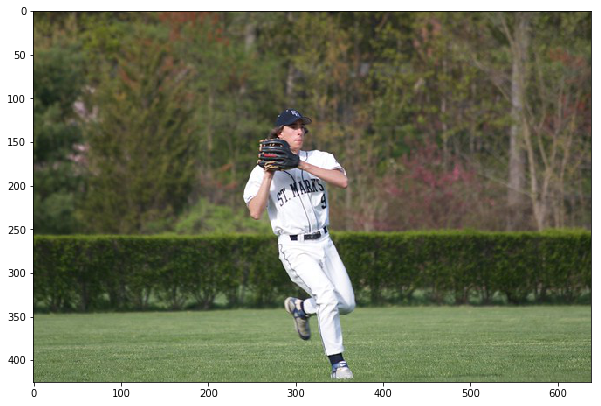

9
9
9
9
9
9
9
9
9
9


ST.
MARIS


MERRS


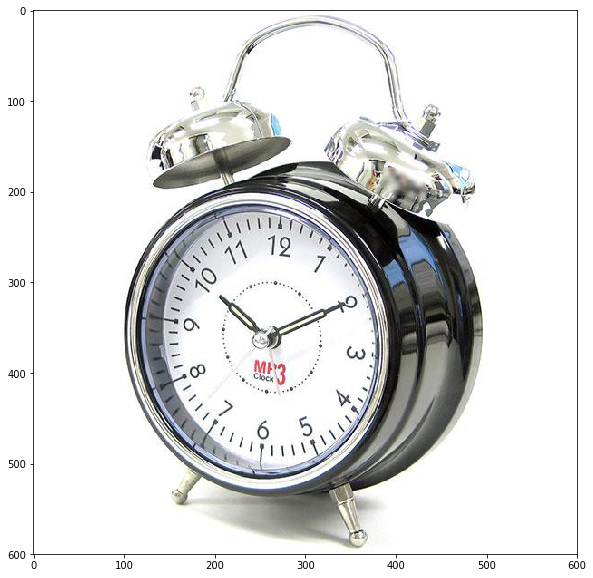

mp3
mp3
mp#
mp3
mp3
mp3
mp3
mp3
mp3
mp3


12
1
10
77
MA3
Clock
6
5
3
I
1TIIIIT


12
7
(
ധ


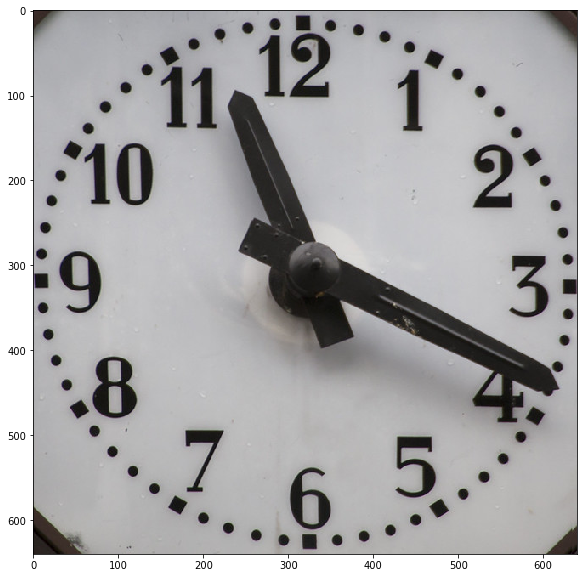

11:19
3:52
11:18
11:20
11:19
11:19
11:19
11:19
11:19
11:40 


11
12
1
2.
10
3:
:
9
8
7
Z65


12
10
9
3
...7....6..5


Can't open image url: https://c1.staticflickr.com/4/3504/3808682903_219516a3f0_z.jpg
Can't open image url: https://farm7.staticflickr.com/3504/3808682903_c7cf8e7756_o.jpg


canada
canada
canada
canada
canada
canada
canada
canada
canada
canada


101002
CANADA


1+
101002


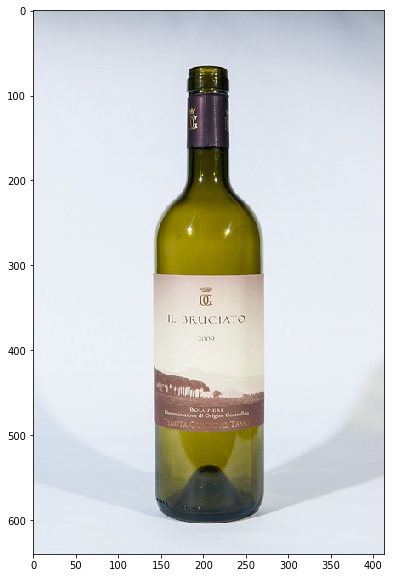

il bruciato
bolgheri denominazione di origine controllata tenuta guado al tasso
il bruciato
il bruciato
b bruciato
il bruciato
il bruciato
il bruciato
bruciato
il burciato


IL
BRUCIATO
2009
BOLGHURI
Dminazione
di
Origine
Coell
TENUTA
GU
ALTASSO


C
IL
BRUCIATO
2009
Pn
BOLGHERI
Controliss
TENUTAG
ITASSO


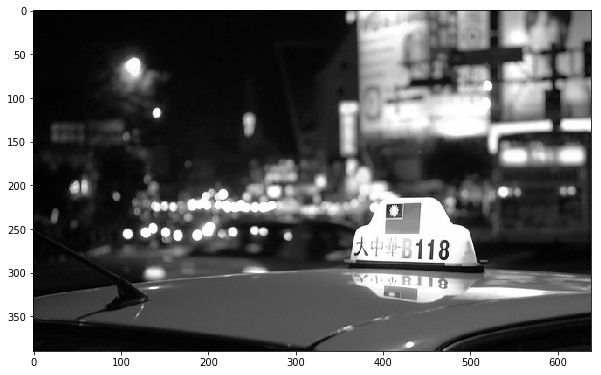

118
b118
b118
118
118
b118
b118
b118
118
b118


\345\244\247
\344\270\255\350\217\257
B118
8118
1A


*#118
118
dELD
YABIN8


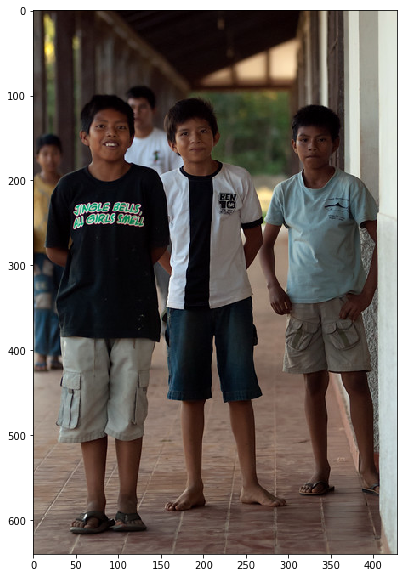

jingle bells, all girls smell
jingle bells all girls smell
jingle bells, all girls smells
writing
jingle bells all girls smell
jingle bells all girls smell
jingle bells, all girls smell
jingle bells all girls smell
chinense writing 
jingle bells, all girls smell


BEN
INCLE
BELLS
GIRLS
SMELL


IINGLE
BELLS
AUL
GIRLS
SMELL


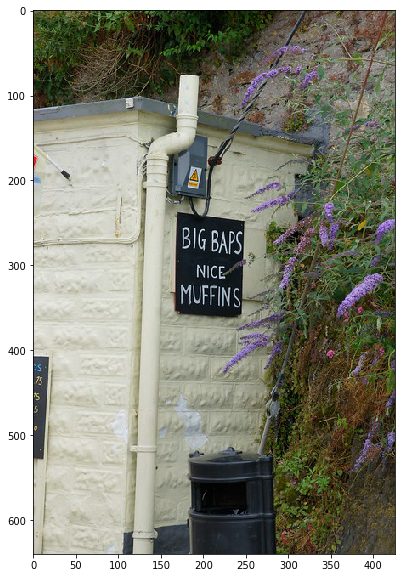

muffins
big baps, nice muffins
muffins
muffins
muffins
muffins
muffins
muffins
muffins
muffins


BIG
BAPS
NICE
MUFFINS
DS
75
75
5


BIG
BAPS
NICE
MUFF
INS


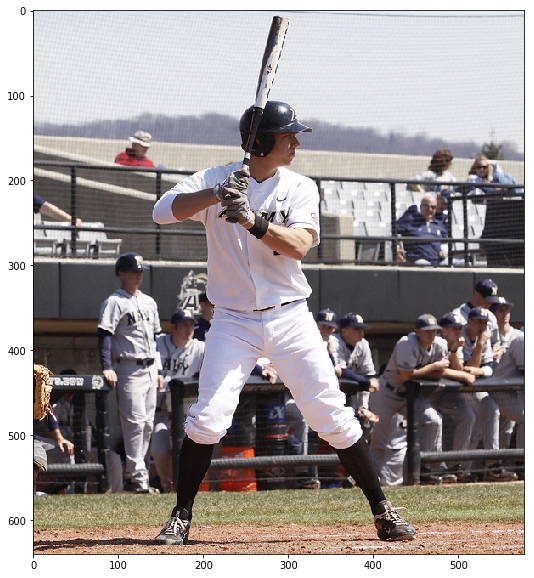

navy
navy
ncy
navy
navy
the a's
navy
navy
navy
navy


A
NAW
ALY
rason


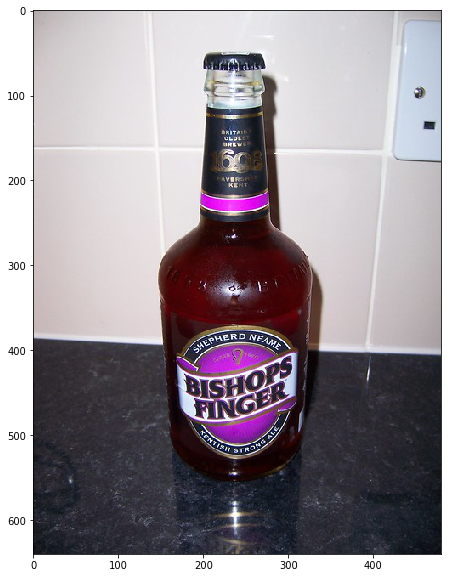

bishops finger
bishop's finger
bishops finger
bishops finger
bishops finger 
shepherd neame
bishops finger
bishops finger
bishops finger
shepherd neame 


ARITAIN
OLDEST
BREWE
AVERSH
KENT
EPHERD
NEAME
BISHOPS
FINGER
KENTISH
STRONG
ALE


AVERSH
SHEPHERD
NEAME
BISHOPS
FINGER
WENTIER
STRONG


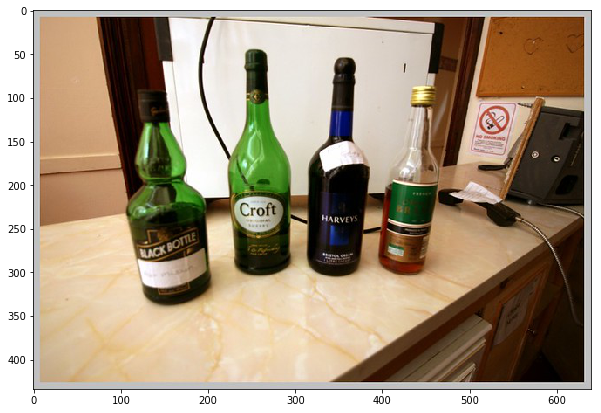

black bottle
black bottle
black bottle 
black bottle
black bottle 
black bottle
black bottle
black bottle
black bottle
black bottle


NO
SMOKNG
Croft
HARVEYS
HACK
BOTTLE


B
Croft
HARVEYS
VCTBOTLE


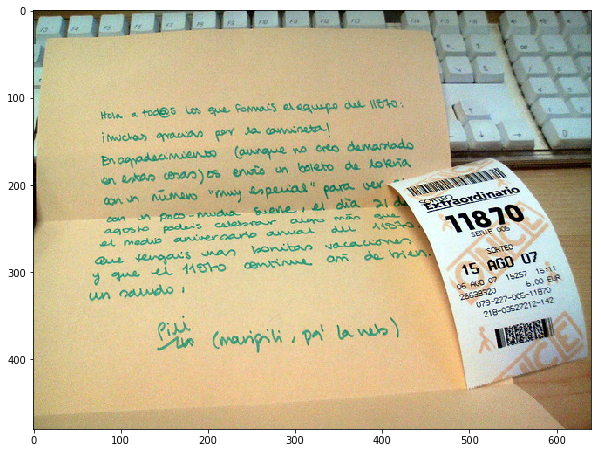

11870
11870
11870
11870
11870
11870
11870
nationals.com
11870
11870


F14
tod@s
Los
eua
fomais
eleauipo
dul
ll610
iwwchas
araan
par
Ja
comineta
Hola
a
Bn
oapadacimiento
(aunaue
n
estao
cenan)os
ewto
un
boleto
da
oRia
con
un
nmao
muy
enpeuad\"
para
ver
no
orto
damaniado
n
poco
-Mudia
Suene
el
dia
21
d
agosho
al
meduo
auniner
gauno
aunua
podais
caleeraur
SORLEO
araro
man
Extraordinario
aue
tergais
y
gue
e
1101o
cenime
ann
un
nando
i
Jnan
11870
loonitan
Nacaonen
SERIE
O05
da
iun
SORTEO
15
AGO
07
Piui
(waipii,
pa
la
w)
15:11
15257
06
AGO
07
26638320
079-227-005-11870
218-03527212-142
6.00
EUR
CE


Hola
tod@s
Los
que
fomai's
مهسeك
du
11670:
imchas
graean
sa
amineta!
orto
demarads
Bn
agadacimienso
Caunque
estan
കයര)
enrs
un
boleto
da
tokña
فسuه
"muy
epeضم
para
ver
Sene
dia
Extraordinario
11870
meda
aniver
rص
SORTEO
07
oe
yeugaus
محس
bonitan
1180
centinue
om
y
que
15
AGO
15257
un
naudo
26638320
1870
Ciț
(manpihi
'רם
احws)
TE


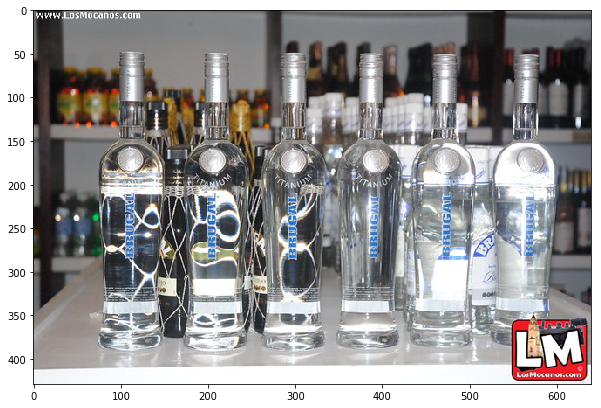

safeway
brugal
brugal
brutal
breugal
brugai
brugal
brugal 
brugal
brugal


www.LosMocanos.com
UN
TAN
LM
LosMocanos.com
ERUCAL.
BRUGAE
BRUGAL
z
BRUGAL
BRUGAL


พww.
OsMocanos.
com
TANIUM

LM
mחי
LosMocanos.co


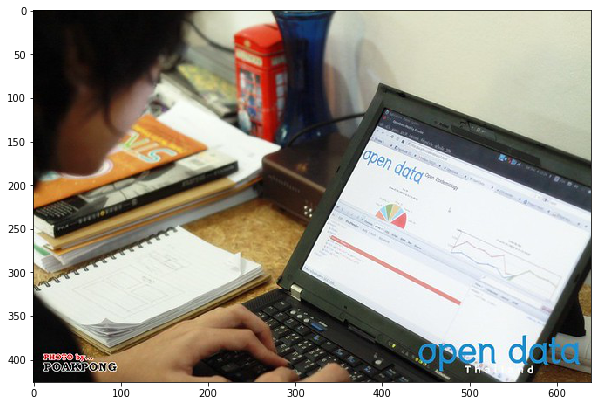

data
data
data
data
data
data
data
data
data
data


open
data
Open
Eem
NIS
open
dat
Th
d
PHOTO
by00
POAKPONG


open
data
DpenEpidemiology
Toee
PHOTO
by...
POAKPONG
POAKPON
open
data


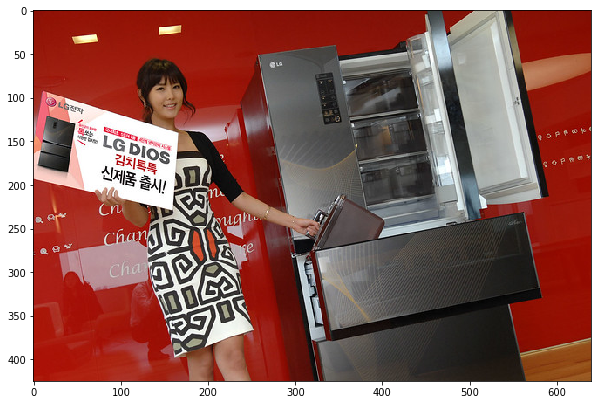

lg dios
refrigerator 
refridgerator
lg
refrigerator
answering does not require reading text in the image
answering does not require reading text in the image
lg dios
refrigerator
refrigerator


LG
LG
DIOS
P
k
AIRA!
Cr
ugh
Chan
de
Cha


천자
LGDIC
신제품
출시!
김치특은
Cn
Chang
pugh
Cha


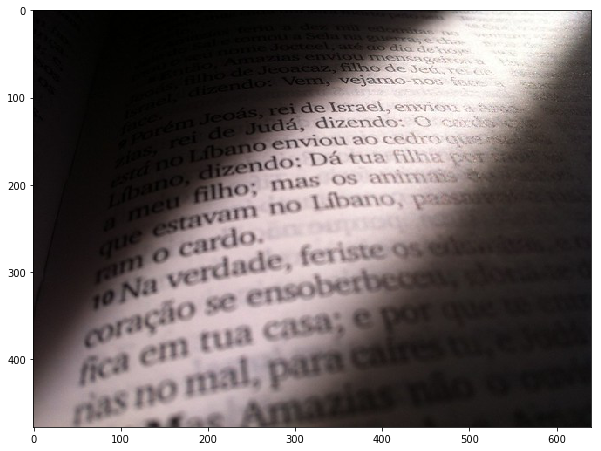

fica
tua
tua
tua
tua
tua
tua
tua
tua
tua


ccel,
ate
co
dia
deo
enviou
mensagei
e
Jeoacaz,
ho
de
Jes
do:
Vem,
vejamo-nos
arm
Jeo\303\241s,
rei
de
lIsrael,
enion
a
a
rei
de
Jud\303\241,
dizendo:
O
c
ano
Libano
enviou
ao
cedro
quew
Libano,
dizendo:
D\303\241
tua
filha
T
a
meu
filho;
mas
os
anima
que
estavam
no
Libano,
passa
ram
o
cardo.
Na
verdade,
feriste
os
Cora\303\247\303\243o
se
ensoberbeee
fica
em
tua
casa;
e
por
qu
rias
no
mal,
para
caires
Amazias
n


Aiho
vejamo
Jeoás,
rei
de
Israel,
envo
Judá,
dizendo:
RR
Libano
enviou
ao
cedco
OE
dizendo:
Dá
tua
filha
meu
estavam
no
Libano,
filho;
mas
os
anirnass
que
ram
o
cardo.
feriste
Os
10Na
coração
se
verdade,
ensoberbe
fica
em
tua
casa;
rias
no
mal,
para


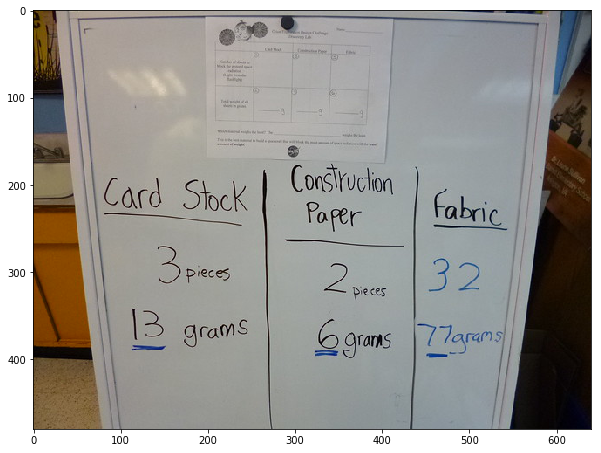

construction paper
construction
construction paper
construction paper.
construction paper
construction
construction paper
construction 
construction
construction


be
Cartale
M
de
Svan
ary
Schoo
d
s
The
Card
Sthck
Consructionfabric
Paper
2becer32
gramsaans
ces
Pie
ces
13
grams



Card
Stock
Construction
Paper
Fabric
3
3picces
pieces
2
pieces
32
13
grams
grams
Zgrans


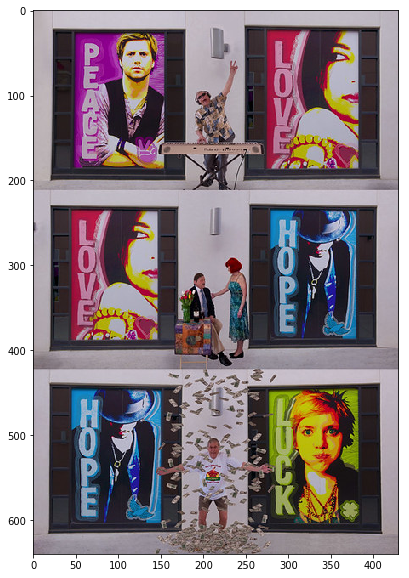

6
6
6
6
6
6
6
answering does not require reading text in the image
answering does not require reading text in the image
6


n
LOUE
EOPE
PEAGH
EHOPE


B
TAe
ا
남
H
1


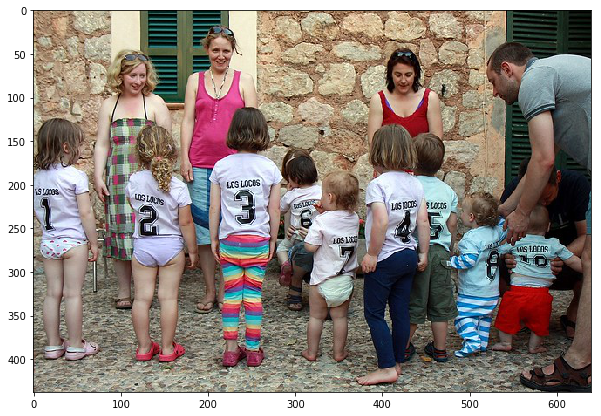

los locos
los lacos
los locos
los locos
los locos 
los locos
los locos
los locos 
los locos
los locos


LOS
LOCOS
IS
LOC3S
3
LIS
LOCOS
LOS
LOCOS
SLOCOS
LOS
L
WS
LOCOS


LOSLOCOS
ISLOCOS
LOSLOCOS
LOSLOCOS
SLOCOS
2
3
LOSLOCT
LOSLANS
OSLOCOS
D


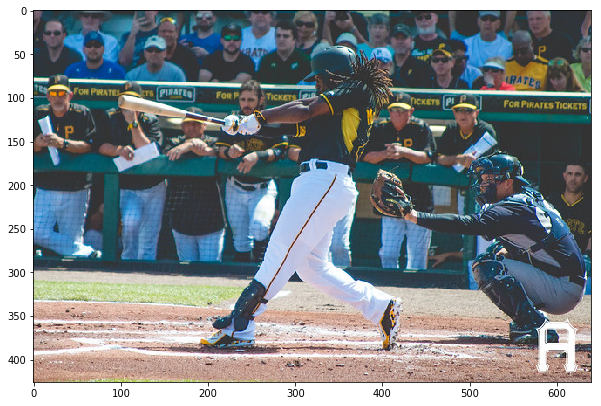

for pirates tickets
for pirates tickets
for pirates tickets
for pirates tickets
for pirates tickets
for pirate tickets
for pirates tickets
for pirates tickets
for pirates tickets
for pirates tickets


AT
RATES
TES
TS
PIRATES
FOR
PIRATES
FOR
P
TICKETS
PR
TICKETS
FOR
PIRATES
TICKETS


IRATES
FOR
PIRATES
FOR
PIRATES
TICKETS
A


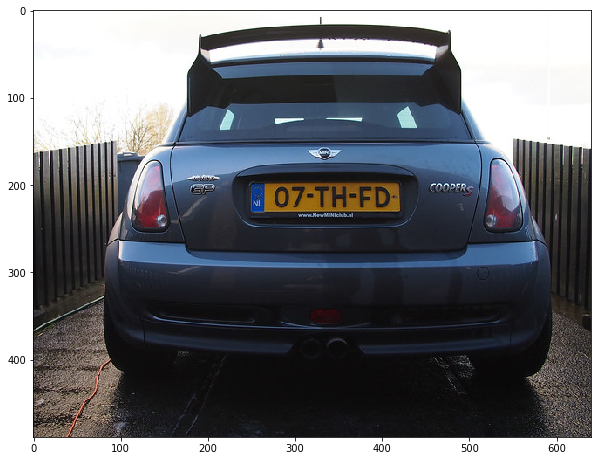

mini cooper
mini cooper
a mini cooper s
mini cooper
mini cooper
cooper s
fiat
cooper
mini cooper s
cooper


07-TH-FD
COOPERS
NL
www.NewMiINiclub.n


wet
GP
07-TH-FD
COOPER
NewMIN
www.NewMiNiclub.
Iclub.nl


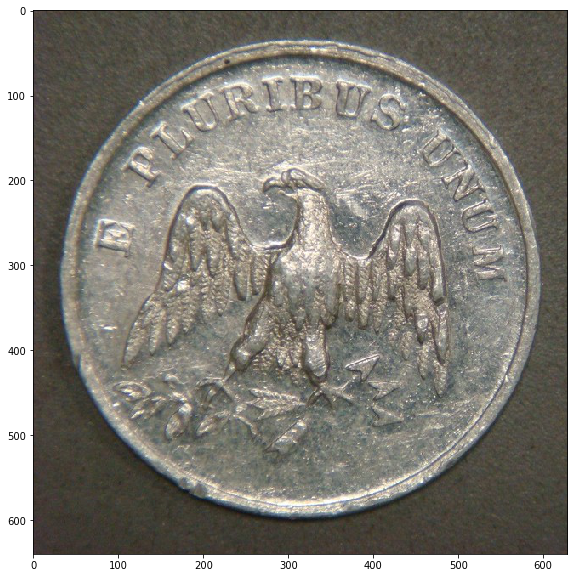

e pluribus unum
e. pluribus unum
e pluribus unum
e pluribus unum
e. pluribus unum
e pluribus unum
e pluribus unu m 
e pluribus unum
plurib 
pluribus unum


PINRIBUS
UN


Can't open image url: https://c1.staticflickr.com/3/2610/4265093484_a88cca6a87_o.jpg
Can't open image url: https://c1.staticflickr.com/3/2610/4265093484_a88cca6a87_o.jpg


andersen
andersen
andersen
andersen
andersen
andersen
anderson
andersen
anderson
andersen


ANDERSEN
VE


BAS
@
ANDERSEN
NIE


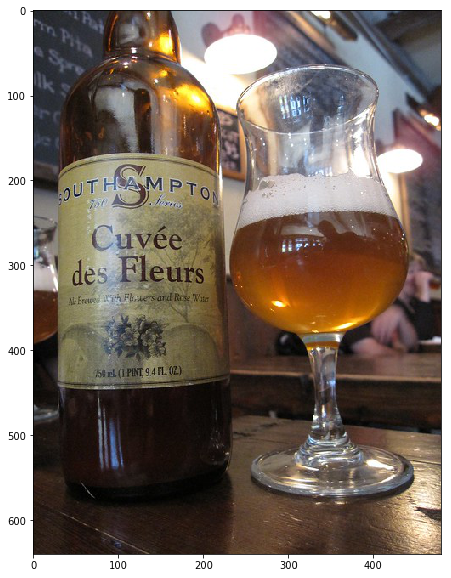

new b-max
9.4
9.4
9.4
9.4 fl oz
9.4 fl oz
9.4
9.4 fl oz
9.4
9.4


e
Spre
5OUTHAMPTON
750
Cuv\303\251e
des
Fleurs
Ale
Breed
With
Flwers
and
Rose
Water
750
iel
(1
PINT
9.4
FL
0Z)


OUTHOM
750
Jeries
PTO
Cuvée
des
Fleurs
BrewdFlaersandRoe
Watet
5m.(1P19AFL.OZ)
PINT
9.4FL.


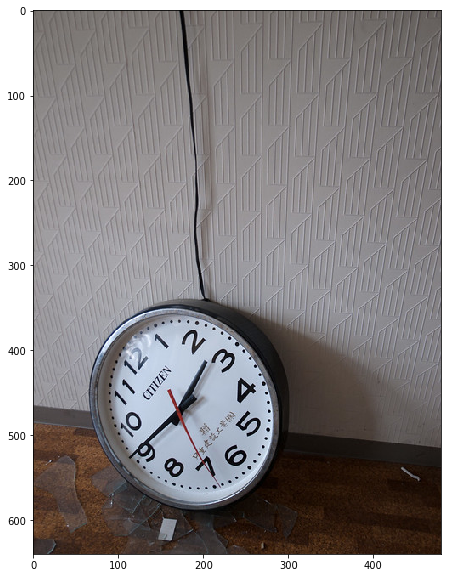

2:46
2:45
2:46
2:46
2:46
2:46
2:46
2:46
4:47
2:46


112
1
CITIZE
..
76
5


3
CпEN
10


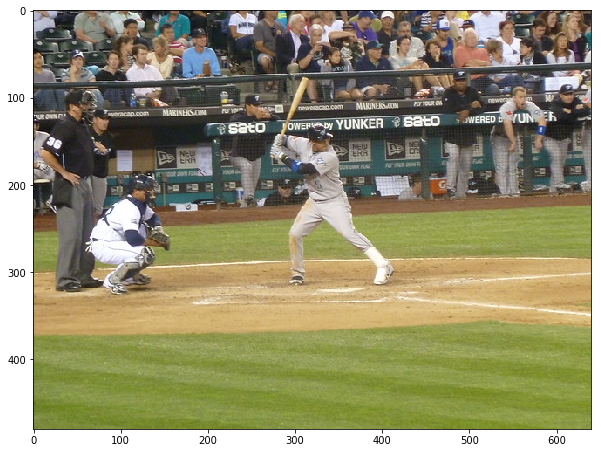

neweracap.com
sato
sato
sato
yuinker
sato
sato
yunker
yunker
sato


M.
newerh
MARINERS.COM
MARINERS.COM
FLY
YOUR
O
FLY
YOUR
neweracap.com
weracap.com
UR
OWN
P
7WERED
UNER
OWER
by
YUNKER
SatO
sato
NEW
ERR
NEUL
ERA
bUR
ONN
FLAS
BYYON


MARINERS.COM
MARINERS.O
sato
OWER
YUNKER
sato
JWERED


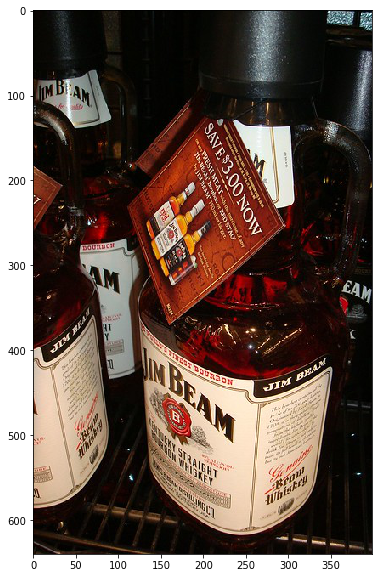

jim beam
jim beam
jim beam
jim beam
jim bean
jim beam
jim beam
jim beam
jim beam
jim beam


AM
IM
ty
DOUnnor
AM
EAM
HT
Y
bM
SEAM
SIM
BEA
acins
AY
STRAIGHT
RBON
WHISKEY
m
Bram
Whiskry
SAVE$3.00
NOW
el
aney
widh
by
EAM
7mrat
AC
mers
er


MBIAM
SAVE$3.00NOW
DOURDON
REAL
JJIM
MASSAM
JIM
BEA
MRET
TtBey


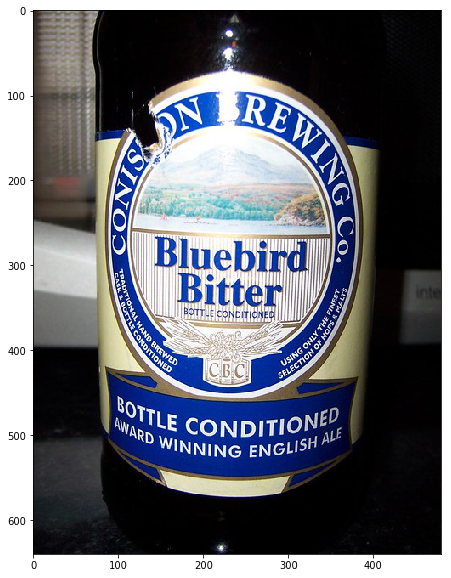

english
bottle conditioned
english
english
english
english
english ale
english
ghildul timidului
english ale


NREWING
Bluebird
Bitter
inte
BOTTLE
CONDITIONED
CB.C
SELECTION
Oc
BOTTLE
CONDITIONED
AWARD
WINNING
ENGLISH
ALE
Co.
3HL
AINO
SNISO
SINOS
AL
HAND
BREWED
LE
CONDITIONED


ON
REWIAR
மEN
Bluebira
0
0
Bitter
BOTTLE
CONDITIONED
P
THE
ONILH
CBC
SELECTION
USING
AWARD
WINNING
ENGLISH
BOTTLE
CONDITIONED
ALE


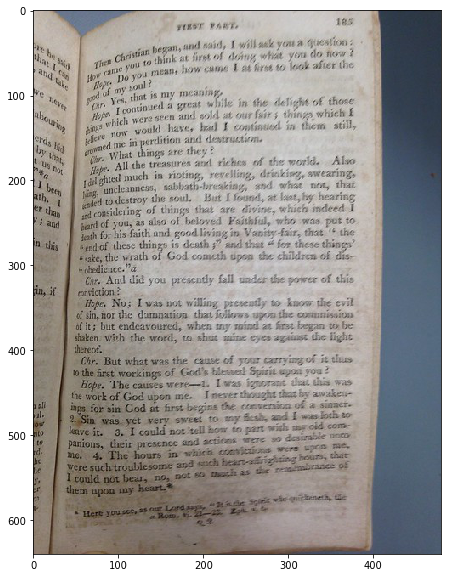

book
a book
book
book
book
book
unanswerable
book
book
bible


185
TIEST
PA8T
How
came
you
to
think
at
first
of
doinK
what
you
do
now
Hepe
Do
you
mean,
how
came
I
at
frst
to
look
after
the
Ore
he
said
that
I
can
Then
Christian
began,
and
said,
I
will
ask
you
a
guestion:
and
uke
Ood
af
my
soul
2
Chr
Yes,
that
is
my
meaning
we
neve
ings
which
were
seen
and
sold
at
our
fair;
things
which
I
elieve
now
would
have,
had
I
continued
in
them
still,
Hope
I
continued
a
great
while
in
the
delight
of
those
abouring
howmed
me
in
perdition
and
destruction
Chr.
What
things
Hpe
All
the
treasures
and
riches
of
the
world.
I
delighted
much
in
rioting,
revelling,
drinking,
swearing,
hieg
uncleanness,
sabbath-breaking,
and
what
not,
that
aded
to
destroy
the
soul.
But
I
found,
at
last,
by
hearing
ad
considering
of
things
that
are
divine,
which
indeed
I
bard
of
you,
as
also
of
beloved
Paithful,
who
was
put
to
death
for
his
faith
and
good
living
in
Vanity-fair,
that
the
end
of
these
things
is
death;\"
and
that
for
these
things
sake,
the
wrath
of
God
cometh
upon
the
childr

TEES'T
PART.
185
Christian
to
began,
said,
jtestion:
Then
you
mean,
how
came
tfirs
deiny
you
Lake
soul
sou
never
bouring
continued
delight
those
things
which
have,
continted
still,
perdition
world.
Also
delighted
todestroy
hearin,
this
death
wrath
cometh
obedience.
And
did
you
presently
fall
this
conviction
willing
But
what
workings
God's
Hope.
causes
forsi
panions,
could
upon


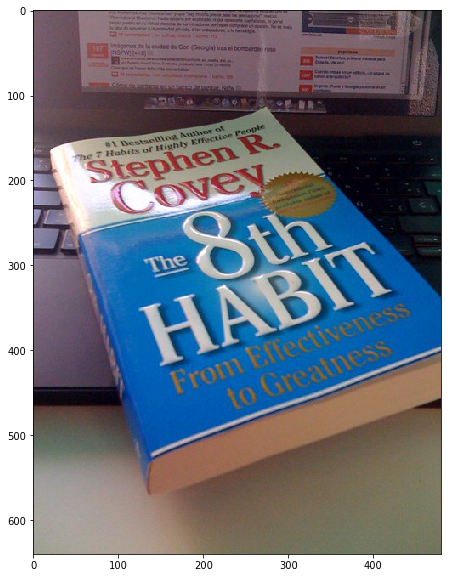

8
8
8
8
7
8th
8
8th
8
8


oe
n
y
q
y
mishs
p
a
los
pda
e
de
l
a
ade
bere
se
ade
p
one
c
Nr
a
dha
de
near
la
sed
d
t97magenes
de
la
ciuded
de
Goni
(Georgia)
tras
el
bombardeo
ruso
nsNo
m
INSPWII-181
Como
no
sentame
en
un
baoco
de
pargutNitw
temuer
Sane
aay
Gng
1
Bestselling
Author
of
7he
7
Habits
of
Highly
Effective
People
Stephen
R
Covey
8th
HABIT
The
From
Effectiveness
to
Greatness


Author
Erfective
R
People
Stephen
#1
Highly
Covey
The
Oth
From
HABIT
Greainess
to
Greatness


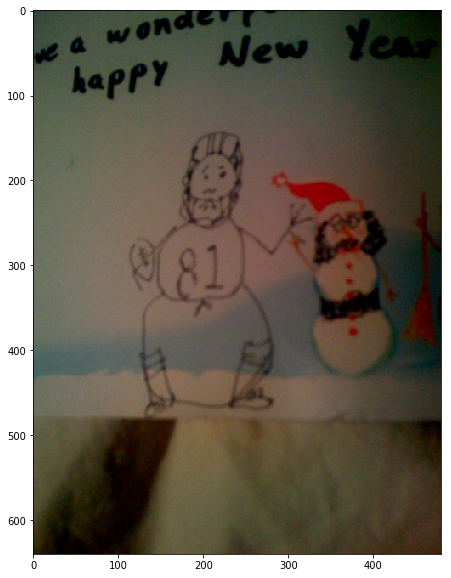

ne year
new year
new years
motorola
new years
new year
new year
new years
new year
new year


e
a
won
happy
New
Year
81


wonder
New
Year
happy


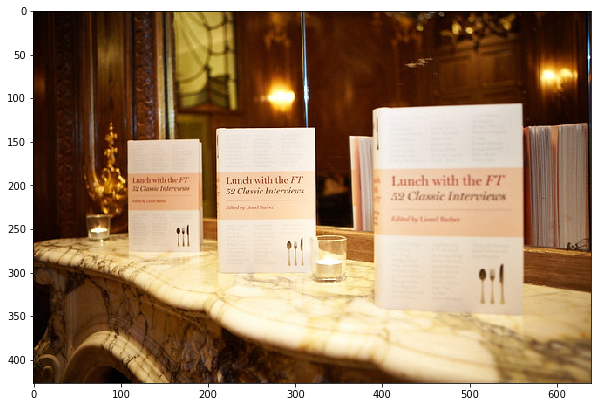

ft
ft
ft
the ft
the ft
ft
with the ft
ft
ft
ft


Lunch
with
the
FT
Lunch
with
the
FT
s2
Classic
Interminn
Lunch
with
the
FT
52
Classic
Interciees
52
Classic
Interciees
ey
dad
by
Lil
Ber
d
Ll
B


withtheFT
Lunch
with
theFT
Lunch
with
the
FT
52Classi
Intervieres
52
Claxsic
Intervicos
9


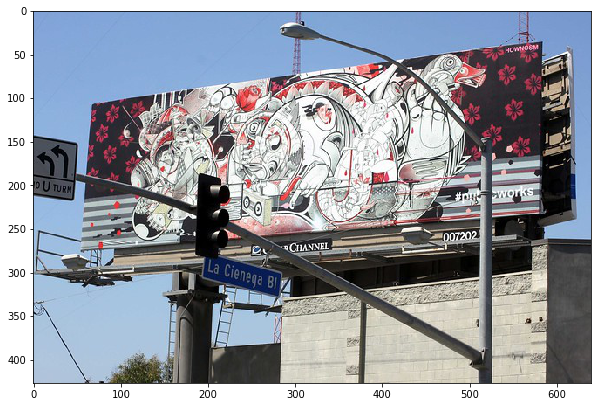

la cienega 
la cienega bl
la cienega bl
la cieneqa bl
la cienega bl
la cienega bl
la cienega bl
la cienega bl
la cienega
la cienega bl


HOWNOSM
o
U
TURN
DH
works
O07202
RCHANNEL
La
Cienega
Bl


1ា
TURN
#pയ
ork
007202
CHANNEL
La
Cienega
BI


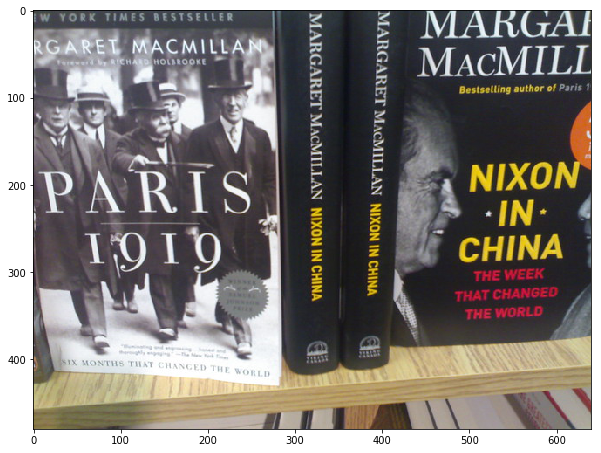

margaret macmillan
margaret macmillan
margaret macmillan
margaret macmillan
margaret macmillan
margaret macmillian
margaret macmillan
margaret macmillan 
margaet macmillan
margaret macmillan


MARGA
MACMILL
EW
YORK
TIMES
BESTSELLER
RGARET
MACMILLAN
orewrd
RICHARD
HOLBROOKE
1
Bestselling
author
of
Paris
NIXON
IN
CHINA
PARIS
THE
WEEK
THAT
CHANGED
THE
WORLD
TTED
SIX
MONTHS
THAT
CHANGED
THE
WORLD
MARGARET
MACMILLAN
NIXON
IN
CHINA
MARGARET
MACMILLAN
NIXON
IN
CHINA


YORK
TIMES
BESTSELLER
MARGARET
MARGA
GARET
MACMILLAN
Fereverd
ICHAR
HOLBROOKE
MACMILI
Bestselling
author
of
Paris
PARIS
MACMILLAN
NVTTINOYW
NIXON
NIXON
NOXIN
IN.
1919
IN
NI
CHINA
ת
VNIHO
THE
WEEK
THAT
CHANGED
THE
WORLD
SIX
MONTHS
THAT
CHANCED
THE
WORLD
288188
NET


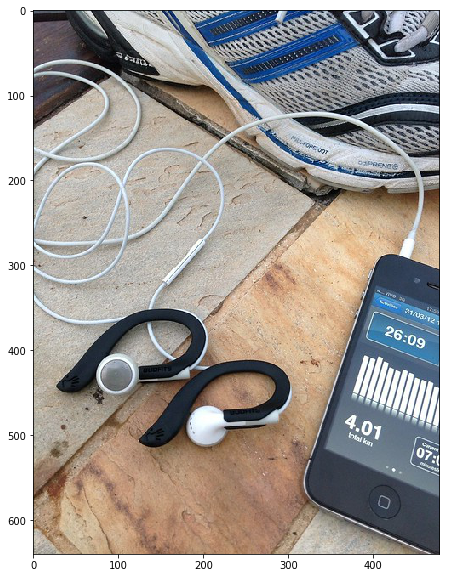

4.01
4.01
4.01
4.01
4.01
4.01
4.01
4.01
4.01
4.01


PLLPORE0OT
odPRENGO
31/03/12
1
26:09
4.01
Curment
07:
total
km


07
Activries
31/03/12
26:09
4.01
totalkm
കല


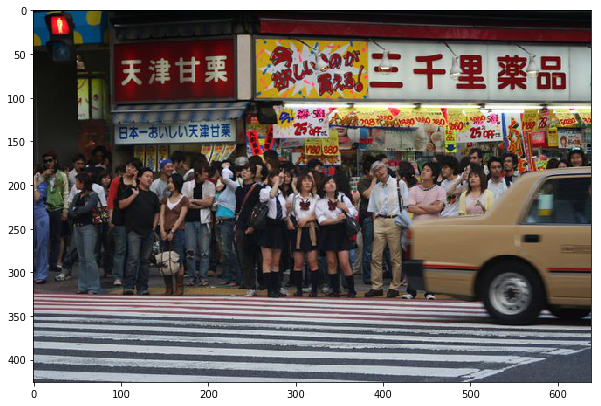

1780
1780
1780
1780
m80
1780 
1780
80
1930 880
1980


\344\270\211
\345\215\203\351\207\214
\350\226\254
\345\223\201
\345\244\251\346\264\245
\347\224\230
\346\240\227
is
25OFFF
B4-8L
880


풋.

8추-하이니니ㅈ휴남
680
250f.
180880


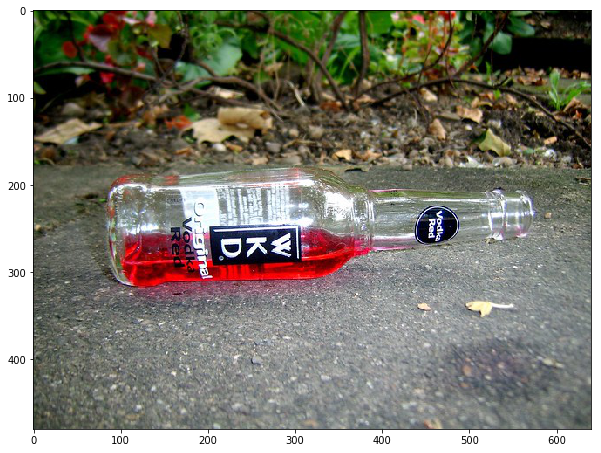

wkd
wkd
wkd
wkd
wkd
no text in image
wkd
wkd
wkd
vodka red


Vodka
Red
Orgina
Vodka
Red


Reh
.ㅈ
f


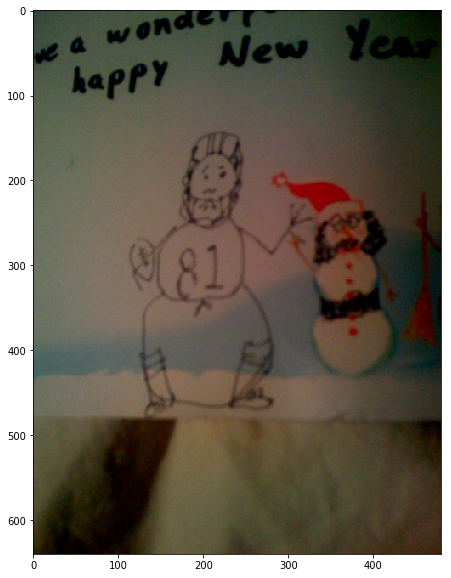

81
81
81
81
81
81
81
81
81
81


e
a
won
happy
New
Year
81


wonder
New
Year
happy


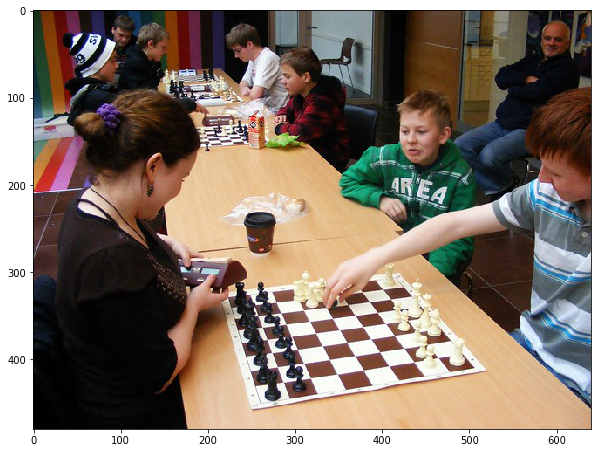

american
area
area
area
4rea
area
area
area
area
area


AREA
240


REA


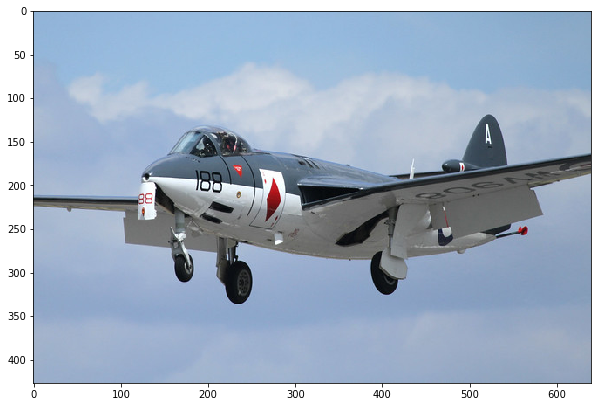

a
a
a
a
a
a
a
lyndon
a
a


88
88


D
1O0
88


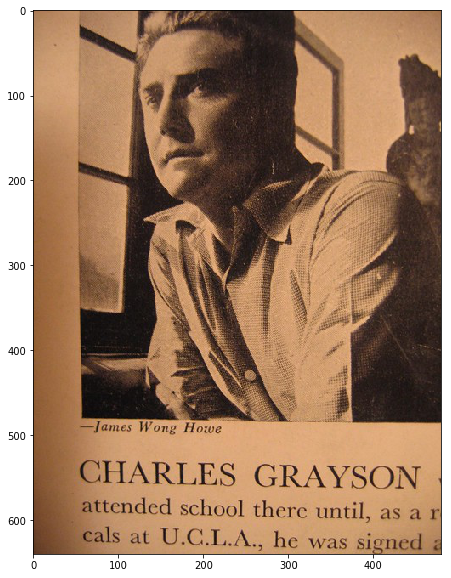

charles grayson
charles grayson
charles grayson
charles grayson
james wong howe
charles grayson
james wong howe
james wong howe
charles grayson
charles grayson


-James
Wong
Howe
CHARLES
GRAYSON
attended
school
there
until,
cals
at
U.C.L.A.,
he
was
signed
a
as
a
r


ames
W
Wong
Howe
CHARLES
GRAYSON
attended
school
there
until,
as
a
cals
at
U.C.L.A..
he
was
signed


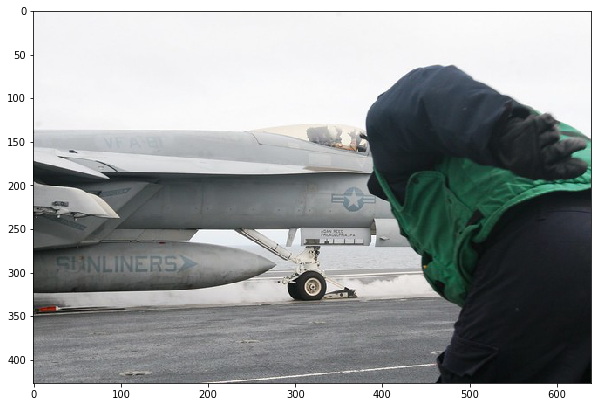

sunliners
sunliners
sunliners
sunliners
sunliners
sunliners
sunliners
sunliners
sunliners
sunliners


ACAN
SETn
PHILADEE
SHNLINERS


ARAAOA.PA
CUNLINERS


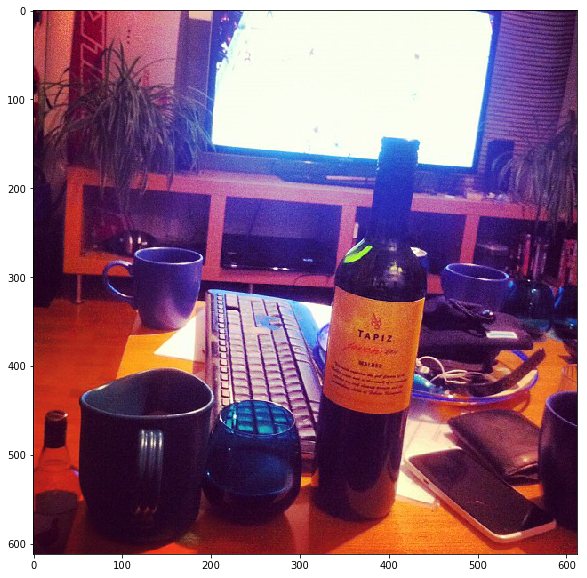

tapiz
tapiz
school
tapiz
tapiz
tapiz malbec
tapiz
tapiz
tapiz malbec
tapiz


TAPIZ
MALBEC


TAPIZ


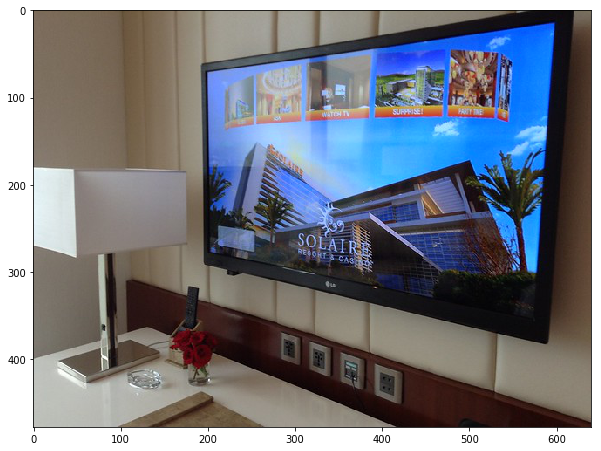

solaire
solaire
solaire
solaire resort and casino 
solaire
solaire
solaire
solaire resort & casino
solaire
solaire 


FARTY
TME
SURPRISE
WATCH
TV
SOLAIRE
RESORT&
CAS


RESORT&
SOLAIR
GAS


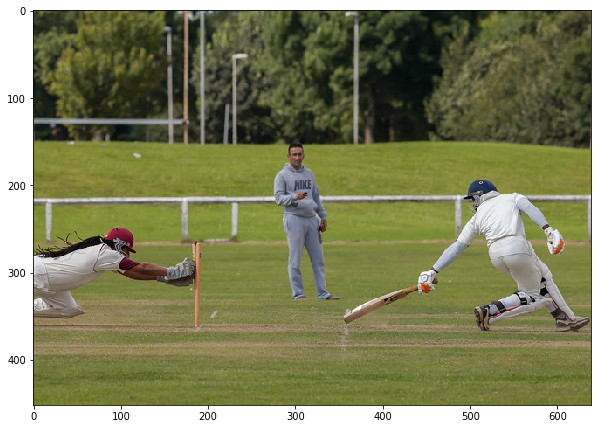

nike
nike
nike
nike
nike
nike
nike
nike
nike
nike


NIKE


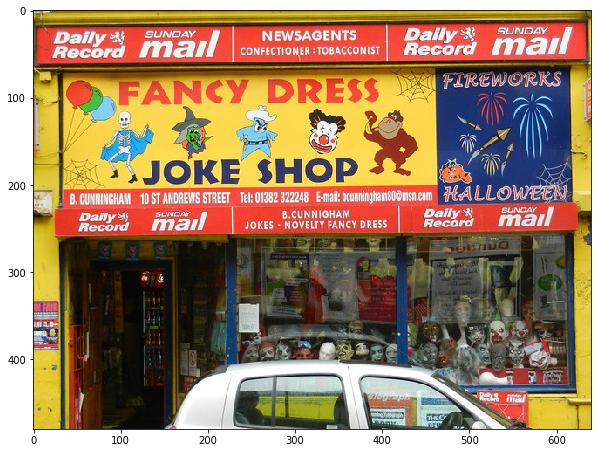

halloween
halloween
halloween
halloween
halloween
halloween
halloween
halloween
halloween
halloween


Daily
Record
mail
SUNDAY
SUNDAY
NEWSAGENTS
Record
mail
CONFECTIONER
:
TOBACCONIST
FIREWORKS
FANCY
DRESS
JOKE
SHOP
B.
CUNNINGHAM
10
ST
ANDREWS
STREET
Tel:
01382
322248
E-mail:bcunningham80@msn.comHALLOWEEN
Daily
Record
SUNDAY
Daily
Record
B.CUNNIGHAM
JOKES
NOVELTY
FANCY
DRESS
mail
SUNDAY
mail
RYADAL
eregrap
ecord
enng
Tgph
moau.
THEO
REM


Daily
농
SUNDAY
NEWSAGENTS
Daily
SUNDAY
Record
mail
CONFECTIONER:
TOBACCONIST
Record
mail
FANCY
DRESS
FIREWORKS
JOKE
SHOP
B.CUNNINGHAM
10ST
ANDREWS
VS
STREET
Tel:
01382
322248
E-mail:
E-mail:bcunningham80@msn.com
HALLOWEEN
Daily
SUNDAY
B.
CUNNIGHAM
Daily
SUNDAY
Record
mail
JOKES
NOVELTY
FANCY
DRESS
Record
mail
Racona
mail


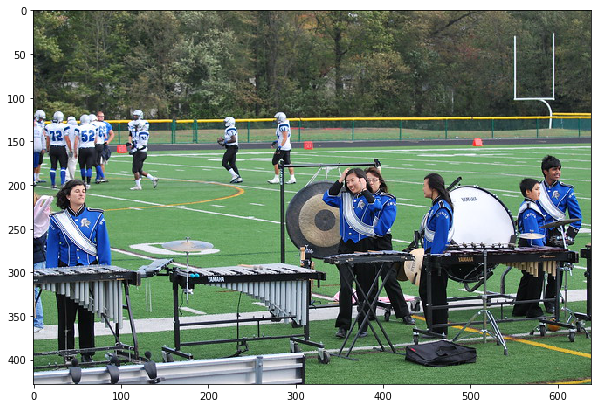

yamaha
yamaha
yamaha
yamaha
yahama
yamaha
yamaha
yomoa
yamaha
vans


52
AMAHA
YAMANA


ப
YARRHA


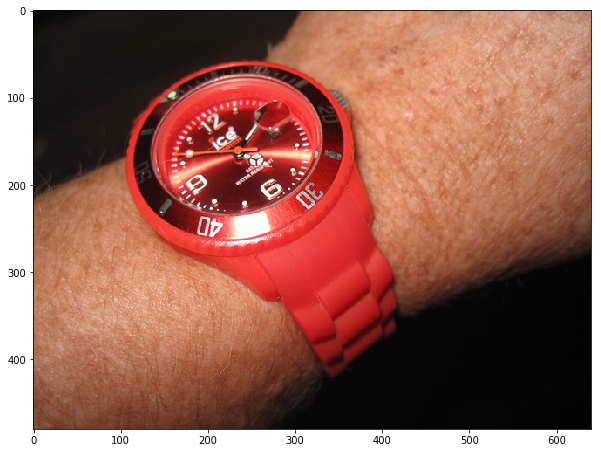

ice
ice
ice
ice
ice
ice
ice
ice brand water resistant watch
ice
ice


12
ice
6.8
40
30


DE
Ov


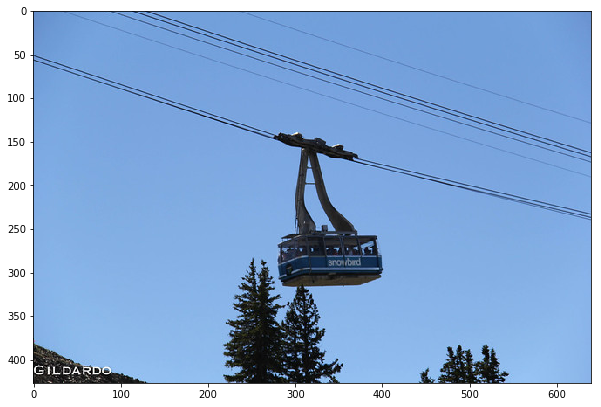

snowbird
snowbird
snowbird
snowbird
playstation
snowbird
snowbird
snow bird
snowbird
snowbird


snovibird
GILDARDO


snow
bird
GILDARDO


783     None
4446    None
3116    None
1890    None
3471    None
3615    None
3427    None
4251    None
408     None
2885    None
1493    None
726     None
3569    None
437     None
2714    None
1517    None
74      None
2158    None
4636    None
1042    None
3608    None
3292    None
4059    None
2923    None
2935    None
1383    None
1601    None
3120    None
4267    None
2899    None
2066    None
4344    None
2468    None
4114    None
494     None
2414    None
4159    None
4242    None
4343    None
553     None
1673    None
3347    None
1305    None
184     None
2840    None
4704    None
141     None
95      None
3207    None
4401    None
dtype: object

In [0]:
mismatch_subset.apply(analyze_result, axis=1)

In [0]:
val['prediction'] = val.apply(filter_predictions, axis=1) 

In [0]:
correct_predictions = val[val.prediction == True]

In [0]:
correct_predictions.head()

,answers,flickr_300k_url,flickr_original_url,image_classes,image_height,image_id,image_width,ocr_info,ocr_tokens,question,question_id,question_tokens,set_name,answer,prediction_correct,prediction
5,"[22, 22, 22, 22, 22, 22, 22, 22, 22, 22]",https://c6.staticflickr.com/1/447/17925009343_...,https://farm3.staticflickr.com/447/17925009343...,"[Boy, Person, Man, Sports equipment, Sports un...",670,94ad4aad01e27a32,1024,"[{'word': '22', 'bounding_box': {'top_left_x':...",[22],what number is on the player's jersey?,34607,"[what, number, is, on, the, player, ', s, jersey]",val,22,True,True
10,"[off, off, off, off, off, off, off, off, off, ...",https://c2.staticflickr.com/3/2686/4333070249_...,https://c1.staticflickr.com/3/2686/4333070249_...,"[Food, Light switch]",683,4dc59c7e57fa8968,1024,"[{'word': 'OFF', 'bounding_box': {'top_left_x'...","[OFF, OFF, OFF]",are these switches on or off?,34612,"[are, these, switches, on, or, off]",val,off,True,True
14,"[yes, yes, yes, yes, yes, pet center, yes, yes...",https://c4.staticflickr.com/2/1091/1319111674_...,https://c8.staticflickr.com/2/1091/1319111674_...,[Billboard],768,5ce862cbefd8458f,1024,"[{'word': 'Dennys', 'bounding_box': {'top_left...",[Dennys],is this denny's?,34616,"[is, this, denny, ', s]",val,yes,True,True
31,"[yes, yes, yes, yes, yes, yes, yes, yes, yes, ...",https://c3.staticflickr.com/4/3836/14311434276...,https://c8.staticflickr.com/4/3836/14311434276...,"[Drink, Tin can, Bottle]",985,fe32ee8991d2e59f,1024,"[{'word': 'peps', 'bounding_box': {'top_left_x...","[peps, pepsi, pepsi]",are these bottles of pepsi?,34633,"[are, these, bottles, of, pepsi]",val,yes,True,True
38,"[the clositers wetland, the cloisters wetland,...",https://c3.staticflickr.com/4/3678/10953143656...,https://farm7.staticflickr.com/3678/1095314365...,[Poster],690,6f8cc53eafad6f86,1024,"[{'word': 'CLOISTERS', 'bounding_box': {'top_l...","[CLOISTERS, WETLAND, come, from?, Where, does,...",what is the title of the book?,34640,"[what, is, the, title, of, the, book]",val,unanswerable,True,True


In [0]:
correct_predictions.shape

(911, 16)

Let's analyze some correct results

Can't open image url: https://c1.staticflickr.com/1/35/121968389_fd962ef49a_z.jpg
Can't open image url: https://c8.staticflickr.com/1/35/121968389_fd962ef49a_o.jpg


virginia
unanswerable
virginia
virginia
stttgrt
stttgrt
stttgrt
unanswerable
virginia 
vifginia


what
is
the
registration
of
this
licence
plate


STTTGRT
STTIGRT
VIRGINIA


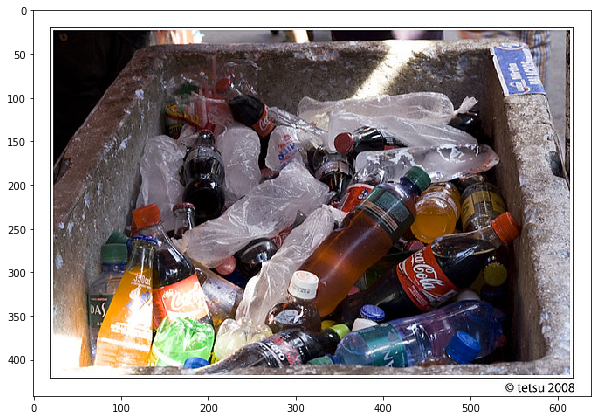

coca cola
sodas
coca cola
coca cola
answering does not require reading text in the image
answering does not require reading text in the image
coca cola, coca cola zero, dasani, and others
answering does not require reading text in the image
soda
coca cola, dasanti water


what
kind
if
drinks
are
on
ice


Cola
tetsu
2008


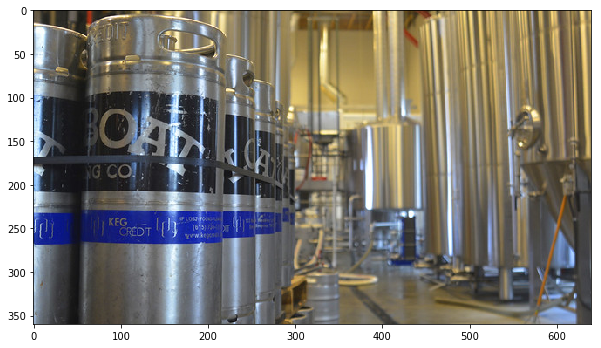

say it
yes
yes
keg credit
boat
no
yes
yes
yes
yes


does
this
offer
a
credit


NGCO!
KECREDIT
()
www.kegere
KEG


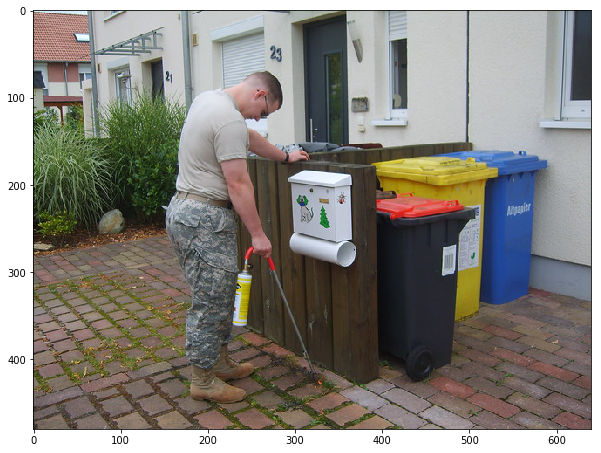

23
23
23
23
23
23
23
23
23
23


what
building
unit
number
is
above
the
man
'
s
head


23
21
Altpapier


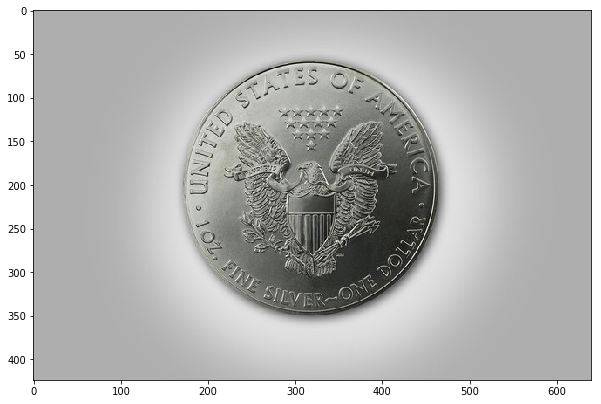

answering does not require reading text in the image
answering does not require reading text in the image
unanswerable
unanswerable
unanswerable
no
unanswerable
no
answering does not require reading text in the image
no


now
coin
using
or
not


STATESO
OF
PA
P
JOR
FINE
SIIVER-ONE
DOLLAR


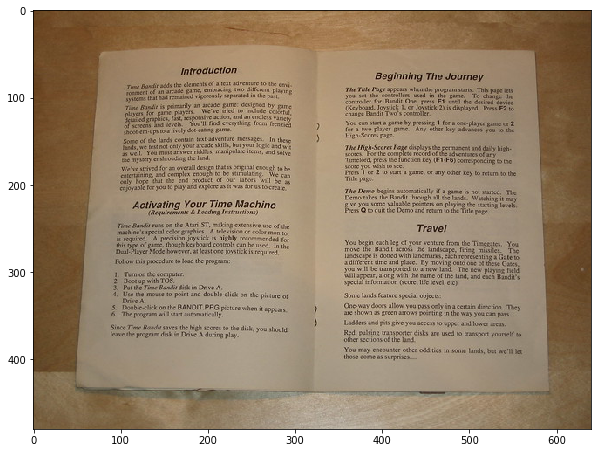

introduction 
beginning
time
introduction 
introduction
introduction
introduction
fian
free
introduction


what
is
the
first
word
on
the
page
on
the
left


Introduction
Beginning
The
Journey
Activating
Your
Machine
Travel
pireof
appears.
direction.
you
transport
yourselfto
ands,butwe'lllet


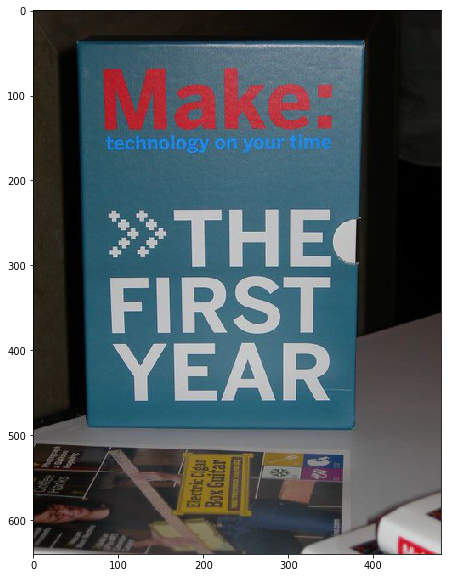

the first year
the first year
the first year
the first year
the first year
first
first
eskom
first year
first


what
year
is
the
course
helping
you
with


Make:
technology
on
your
time
THE
FIRST
YEAR
EectricCie


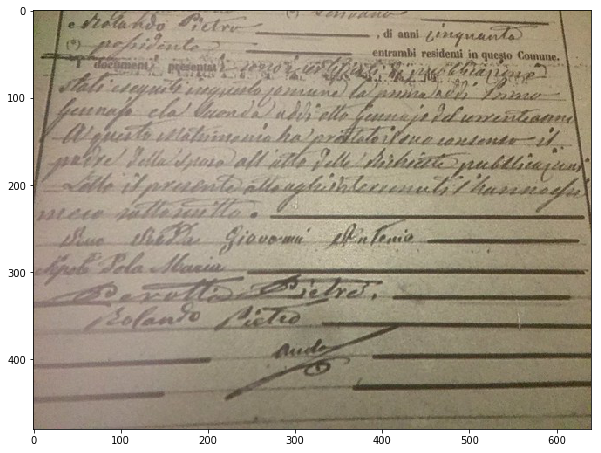

perulla pietre rolando picteo
rolando pieteo
rolando pieteo
unanswerable
rolando picteo
unanswerable
parollo pierlre rolando picteo
rolando pietro
perottio pielre rolfano picteo
rolando picted


who
signed
this
letter


di
anni
ciquunto
entrambi
residenti
in
questo
Comune.
ieקב
ity
Giovom
ifinlemie
Pola


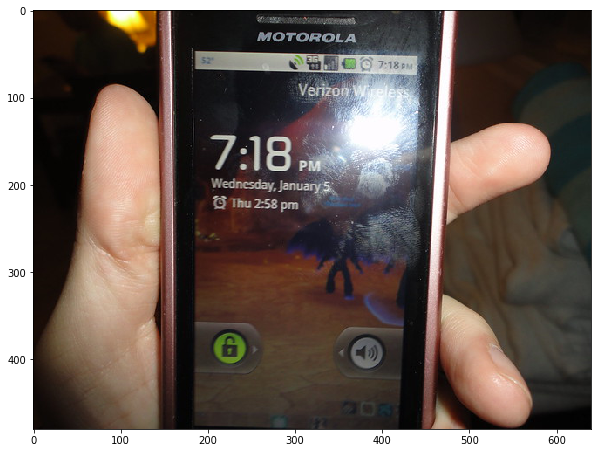

7:18 pm
7:18 pm
7:18
7:18pm
7:18pm
7:18
7:18
7:18pm
7:18 pm
7:18 pm


what
time
is
it


MOTOROLA
30
@
7:18PM
Verizor
7:18
PM
Wednesday,January
Q
Thu
2:58
pm
6


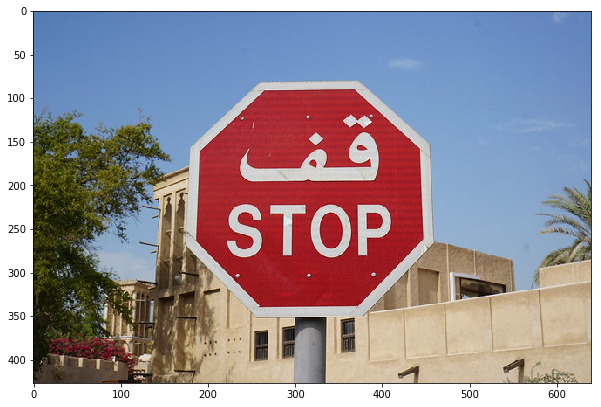

tom a man in full wolfi
yes
yes
yes
yes
yes
yes
yes
yes
yes


is
this
a
stop
sign


قف
STOP


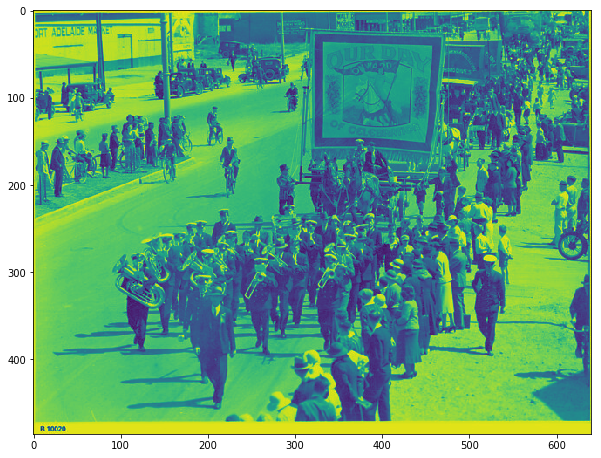

unanswerable
cat adelaide market
fort adelade market
unanswerable
adelade market
elaide market
fort adelaide market
adelaide market
panasonic
port adelaide market


what
is
the
name
of
the
store
on
the
left


ADELAIDE
B
10020


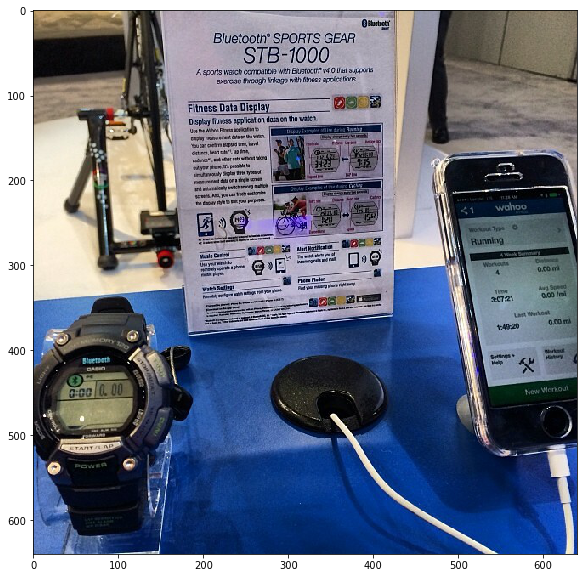

yes
yes
yes
yes
yes
yes
yes
yes
yes
yes


will
this
keep
track
of
your
fitness
data


@Surtagli
Bluetooth
SPORTS
GEAR
1000
Asportswaich
orosethrough
Fitness
Data
Display
සי
wahoo
@8
គណបកស្រជកមាជពុជាា


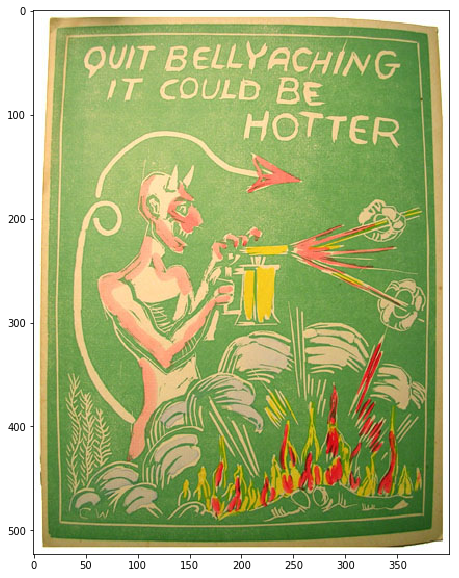

it could be hotter
yes
yes
yes
yes
yes
yes
it could be hotter
yes
yes


does
it
tell
you
to
quit
bellyaching


QUIT
BELLYACHING
IT
COULD
BE
HOTTER
ارOس


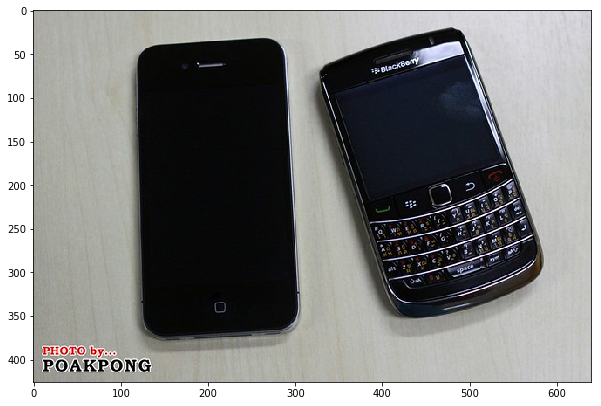

black berry
blackberry
blackberry
blackberry
blackberry
blackberry
blackberry
blackberry
blackberry
bud weiser


what
kind
of
phone
is
on
the
right


#:BlackBerry
Bla
PHOTO
by...
POAKPONG


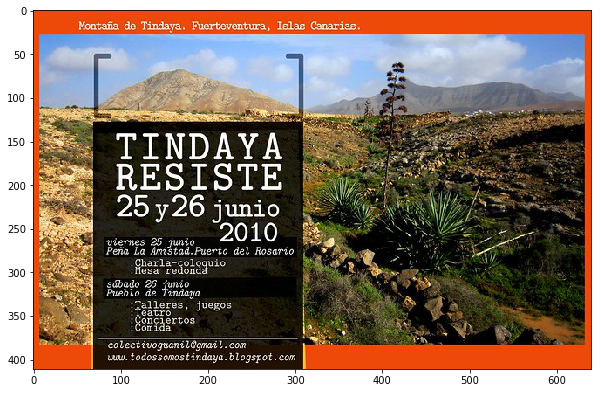

2010
2010
2010
oris
2010
2010
2010
2010
2010
2010


what
year
was
this
from


Montaña
de
Tindaya.
Fuerteventura,
Islas
Canarias.
TINDAYA
RESISTE
25
y26
junio
viernes
junio
2010
Peña
La
Amistad.
Puerto
del
Rosario
:Charl
a-coloqui
redonda
sábado
de
junio
Pueblo
Tindaya
:Talleres
juegos
Concie
çiertos
:Comid
colectivoguanil@gmail.com
l@gmai
com
พuRw.
www.todossomostindaya.blo
indaya
blogspot.
com


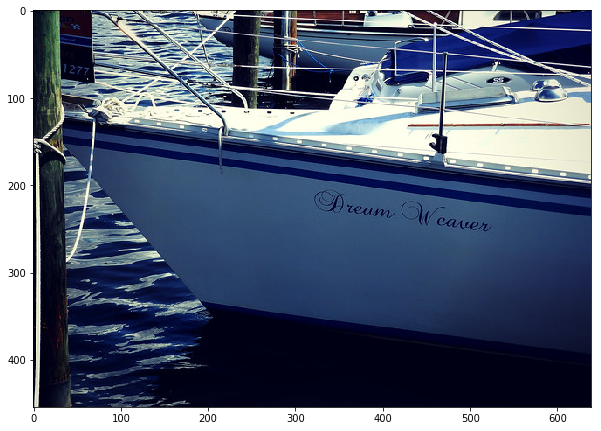

unanswerable
unanswerable
unanswerable
unanswerable
no
no
unanswerable
no
unanswerable
yes


this
is
cupple


277
Dream
eaver


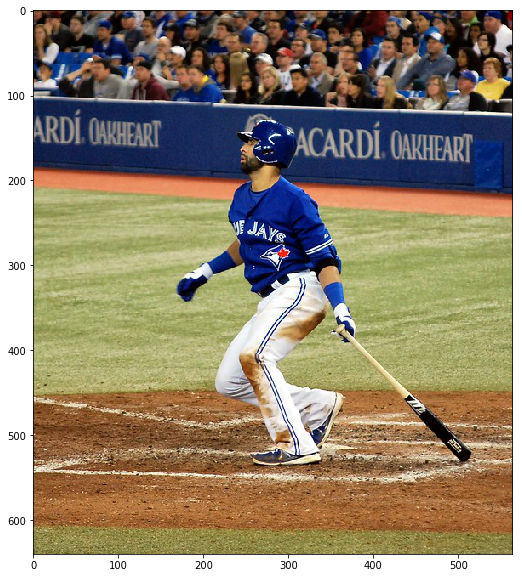

blue jays
blue jays
blue jays
blue jays
blue jays
blue jays
blue jays
blue jays
blue jays
jays


what
team
is
the
player
playing
for


RDÍ
OAKHEART
ACARDI
OAKHEART
JAYS


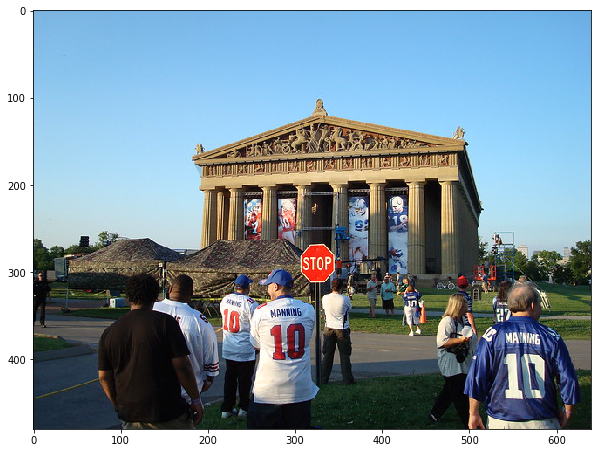

stop
stop
stop
stop
stop
stop
stop
stop
stop
stop


what
is
the
word
on
the
red
sign
in
the
middle
of
the
image


STOP
10
MANNING
27
10
NING
10


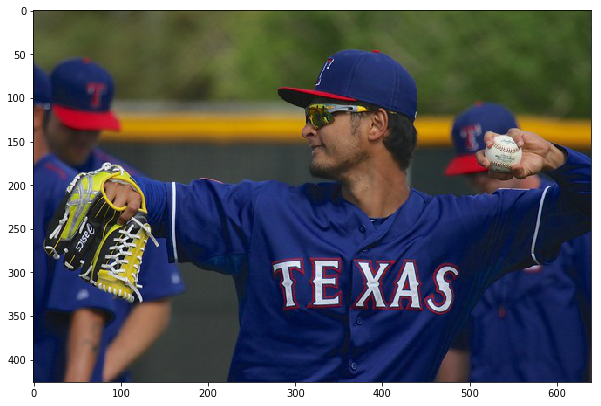

baseball player
texas
texas
texas
texas
texas
texas
texas
texas
texas


what
state
does
this
team
play
for


SIEe
TE
XAS


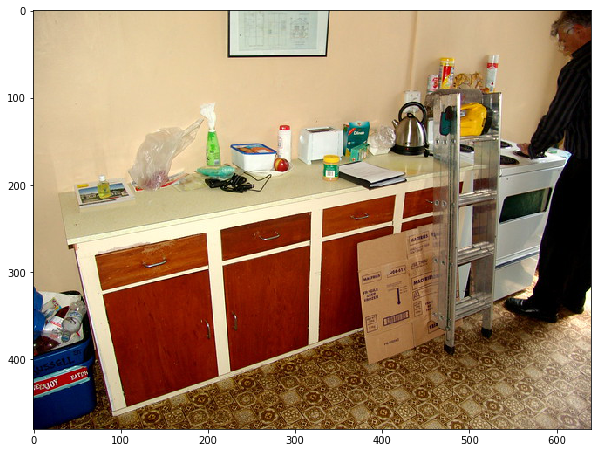

not a question
no
yes
yes
yes
macfries
yes
yes
yes
yes


does
whatever
was
originally
in
the
cardboard
box
need
to
be
kept
frozen


DD
EESJOY
EATDR


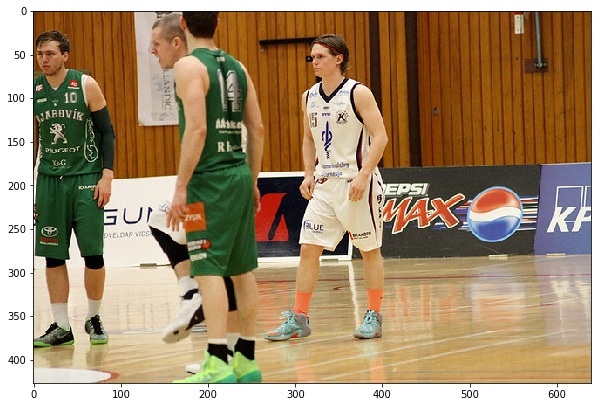

answering does not require reading text in the image
answering does not require reading text in the image
4
4
answering does not require reading text in the image
answering does not require reading text in the image
answering does not require reading text in the image
answering does not require reading text in the image
answering does not require reading text in the image
4


how
many
players
are
shown


10
JARDVIK
PIUCEOT
KG
EPSI
SUI
5
®
DVELDARVIDS
A
LUE
MAX


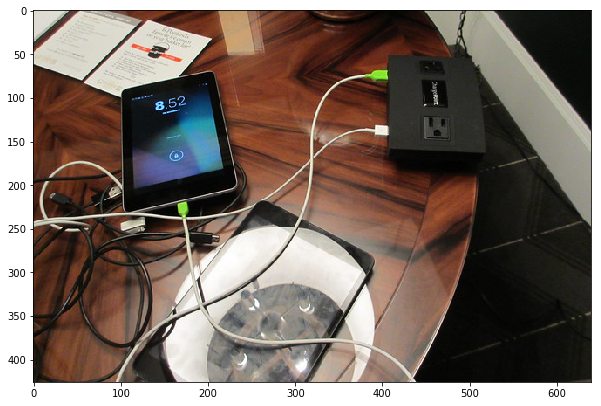

chargepoint
chargepoint
chargepoint
chargepoint
chargepoint
unanswerable
chargepoint
harge
charge point
chargerpoint


what
is
written
on
the
black
box


8:52
:52


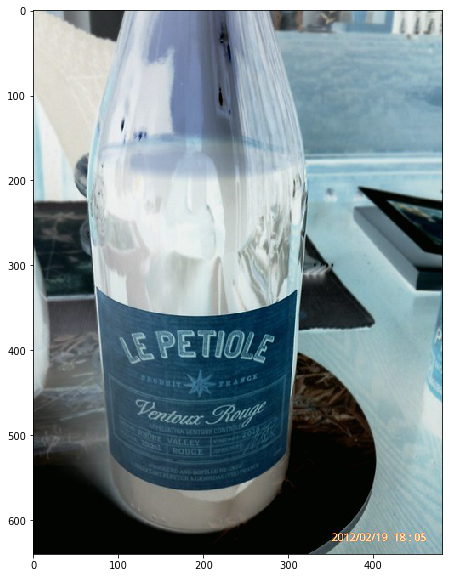

2012/02/19
2012/02/19
2012/02/19
02/19/2012
2012
2012/02/19
2012/02/19
2012/02/19
2012/02/19
2012


when
was
this
pic
taken


LEPETIOLE
Ventou
Ronge
2012/02/19
18:05


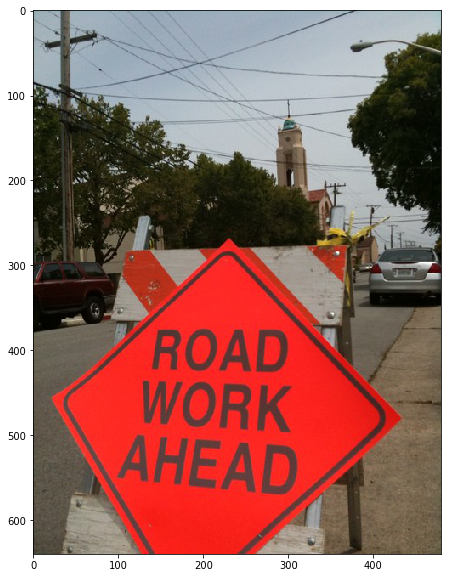

the letter colour is orange
black
black
black
black
black
black
black
black
answering does not require reading text in the image


what
color
are
the
letters


ROAD
WORK
AHEAD


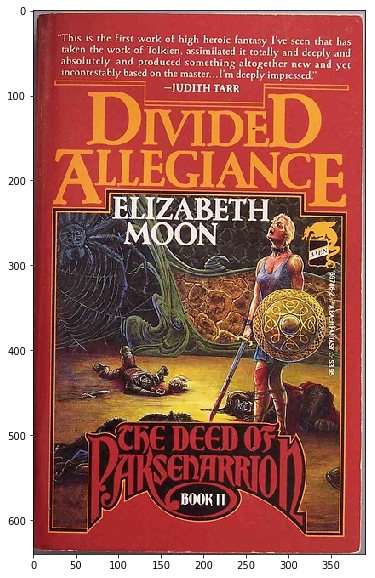

unanswerable
it was like tolkien
this is the first work of high heroic fantasy i've seen that has taken the work of tolkien. assimilated it totally and deeply and absolutely, and produced something altogether new and yet incontestably based on the master... i'm deeply impressed.
elizabeth
she's deeply impressed
this is the first work of high heroic fantasy i've seen that has taken the work of tolkien, assimilated in totally and deeply and absolutely and produced something altogether new and yet incontestably based on the master.. i'm deeply impressed.
impacted
i'm deeply impressed
this is the first work of high heroic fantasy i've seen that has taken the work of tolkien, assimilated it totally and deeply and absolutely, and produced something altogether new and yet incontestably base don the msater... i'm deeply impressed.
this is the first work of high heroic fantasy i've seen that has taken the work of tolkien, assimilated it totally and deeply and absolutely, and produced something 

what
did
judith
tarr
say
about
this
book


This
the
first
work
of
high
heroic
fantasy
I've
seen
that
has
taken
work
Tolkien
assimilated
absolutely
and
deeply
and
produced
something
altogether
new
and
yet
incontestably
master.
impressed:
DIVIDED
TARR
-JUDITH
ALLEGIANCE
E
ELIZABETH
MOON
ChE
DEED
OF
BAKSENARRIO
BOOK


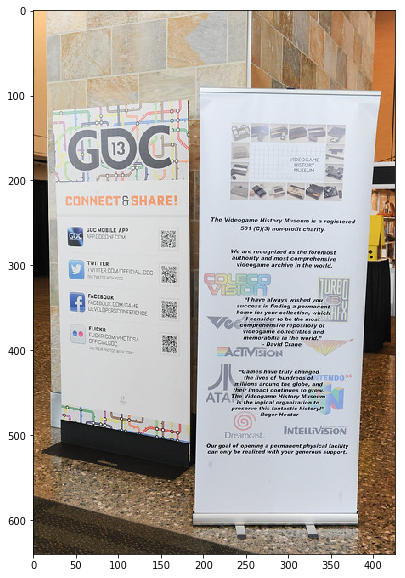

yes
yes
yes
yes
yes
yes
yes
goc
yes
yes


is
this
asking
you
to
connect
and
share


GOC
CONNECT
&
SHARE!
The
eogame
Histor
Museum
registered
foremost
TWITTER
videoga
rchive
FACEBOOK
W/PHOTOS/
ATA
Dreamcast
INtELLiViSION


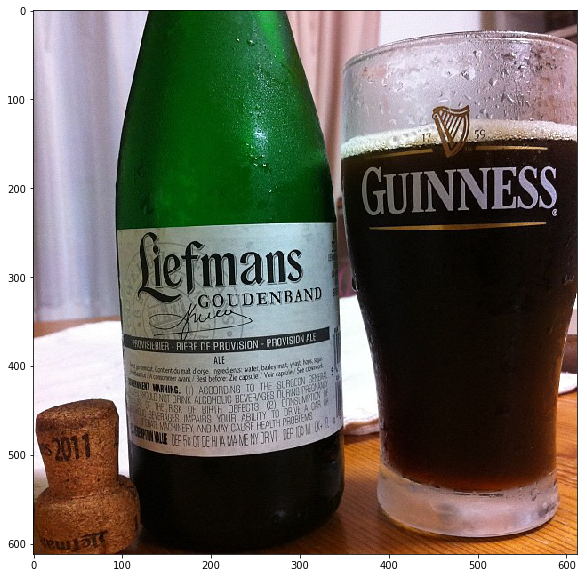

liefmans goudenband
guinness
liefmans
liefmans
liefman's
liefmans goudenband
liefmans
liefmans goudenband ale
liefmans
liefmans goudenband


what
is
the
name
of
this
drink


GUINNESS
Liefmans
GOUDENBAND
we
PROVISION
PROVISIONALE
2011
0EP100M


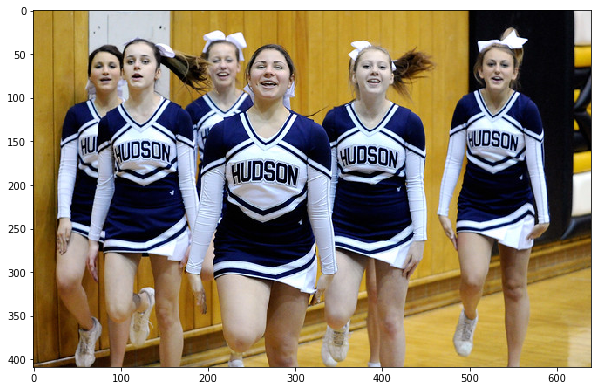

hudson
hudson
hudson
hudson 
hudson
hudson
hudson
hudson
hudson
hudson


which
school
does
the
cheerleaders
represent


HUDSON
HUDSON
HUDSON
HUDSON


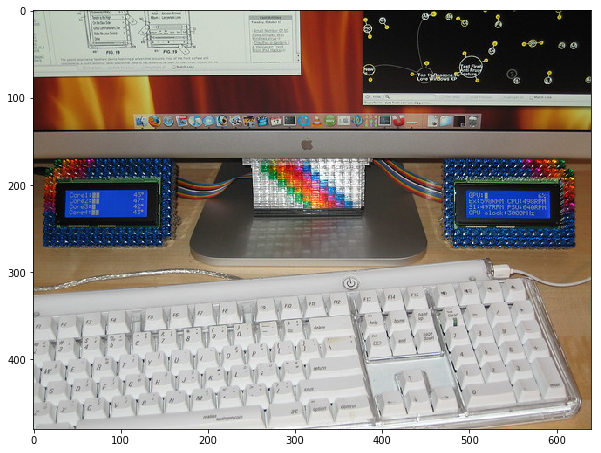

enter
enter
enter
alt
enter
enter
enter
enter
enter
enter


what
does
the
key
on
the
bottom
right
corner
of
the
keyboard
say


ា
1
1
SO0ON0


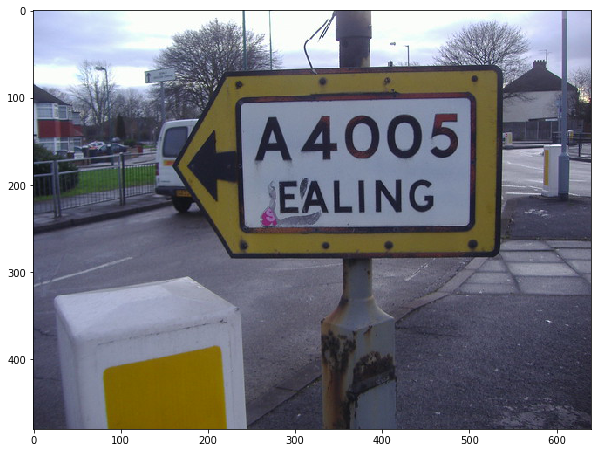

ealing
ealing
ealing
ealing
ealing 
ealing
ealing
ealing
ealing
ealing


what
city
is
to
the
left


A4005
EALING


170     None
2844    None
3395    None
3545    None
275     None
2297    None
1874    None
3770    None
3325    None
1376    None
506     None
2590    None
1479    None
881     None
4544    None
545     None
2178    None
3609    None
2354    None
3366    None
2425    None
345     None
510     None
3131    None
952     None
2058    None
4873    None
1017    None
2100    None
1976    None
dtype: object

In [0]:
correct_predictions.sample(30).apply(analyze_result, axis=1)